In [26]:
import dill
import pickle
import numpy as np
import pandas as pd
import cv2
import matplotlib
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
import glob
import os
import pdb
#import ipynb.fs.full.AnglesFuncs as af

In [27]:
def splitFigure(image, numParts):

    imSize = image.shape
    print(imSize)
    xcut = 10
    ycut = 10
    ywindow = imSize[0] - 280 - ycut
    xwindow = int((imSize[1] - (xcut *(numParts+1))) / numParts)
    result = np.zeros((ywindow, xwindow, 3, numParts), dtype='int16')
    
    for i in range(numParts):
        xminlim = xcut *(i+1) + (xwindow) *i 
        xmaxlim = xcut *(i+1) + (xwindow) *(i+1)
        
        print(i, xminlim, xmaxlim)
        result[:,:,:,i] = image[ycut:ywindow + ycut, xminlim:xmaxlim, :]
        #plt.imshow(image[ycut:ywindow + ycut, xminlim:xmaxlim, :])
       # plt.show()
    
    return result

In [37]:
folder = "results_discussion/camera_135TBB_CB/"
file = "135TBB_CB_ink2.JPG"

#numOfSamples = [9, 10, 11, 12]
#numOfSamples = [7, 8, 17, 18]
#numOfSamples = [1, 2, 3, 4, 5, 6]
#numOfSamples = [1, 2, 7, 8, 13, 14]
#numOfSamples = [20, 21, 11, 12, 9, 10]
#numOfSamples = [24, 25, 22, 23, 1, 2]
#numOfSamples = [11, 12, 15, 16, 17, 18]
#numOfSamples = [28, 29, 26, 27]
#numOfSamples = [32, 33, 30, 31]
#numOfSamples = [1, 2, 5, 6, 3, 4]
#numOfSamples = [9, 10, 7, 8]
#numOfSamples = [70, 67, 69]
numOfSamples = [58, 59, 52, 54, 60, 61, 62, 63]

image = cv2.imread(folder + file)

Imgs = splitFigure(image, len(numOfSamples))
    
for i in range(len(numOfSamples)):
    newIm = Imgs[:,:,:,i]
    cv2.imwrite(folder + file [:10] + 'sample' +
                str(numOfSamples[i]) + '.jpeg', newIm)
    #plt.imshow(newIm)
    #plt.xticks([])
    #plt.yticks([])
    #plt.savefig(folder + file [:13] + 'sample' +
     #           str(numOfSamples[i]) + '.jpeg', dpi=1000)



(1191, 3600, 3)
0 10 448
1 458 896
2 906 1344
3 1354 1792
4 1802 2240
5 2250 2688
6 2698 3136
7 3146 3584


In [29]:
#--------------------------------------------------------------
def FindThreshold(FFT, alpha):
    TH = np.mean(FFT)
    ref = 0.1
    totAmp = np.sum(FFT)
    diff = 100
    i = 0
    
    while ((np.abs(diff) > ref) | (i < 100)):
        _, thresh = cv2.threshold(FFT, TH, 1,
                                  cv2.THRESH_BINARY)
        relAmp = np.sum(FFT*thresh)
        # number of bins over the TH
        n = np.sum(thresh)
        diff = (alpha*totAmp - relAmp) / n
        
        TH += (-1 * diff /50)
        i += 1
        
    return TH

#--------------------------------------------------------------
def draw_vector(img, v0, v1):
    cv2.line(img, v0, v1, (0,255,0),10)
    #ax = ax or plt.gca()
    #arrowprops=dict(arrowstyle='->',linewidth=2,shrinkA=0, shrinkB=0)
    #ax.annotate('', v1, v0, arrowprops=arrowprops)

#--------------------------------------------------------------
def find_main_component_dft(item, th):
    # item: address of the image
    # th: Threshold
    # figAddress: address of the figure folder
    figfolder = "figures/"
    
    # extracting info from the name
    idx = [i for i in range(len(item)) if item[i] == '/']
    folder = item[0:np.max(idx)+1]
    name = item[np.max(idx)+1:-4]
    
    image = cv2.imread(item)
    
    # dft and mag
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    dftIm = cv2.dft(np.float32(image),flags = cv2.DFT_COMPLEX_OUTPUT)
    dftImShift = np.fft.fftshift(dftIm)
    magIm = 20*np.log(cv2.magnitude(dftImShift[:,:,0],dftImShift[:,:,1]))
    
    size_img = image.shape
    
    # plot gray image
    plt.figure(figsize=(20,12))
    plt.imshow(image, cmap = 'gray')
    plt.title('Original Image', fontsize=25)
    plt.xlabel('x', fontsize=20)
    plt.ylabel('y', fontsize=20)
    plt.xticks()
    plt.yticks()
    plt.savefig(folder + figfolder + name + '_gry.png')
    
    # plot magnitude
    plt.figure(figsize=(20,12.3))
    plt.imshow(magIm, cmap = 'gray')
    plt.axis('equal')
    plt.title('Magnitude of FT', fontsize=25)
    plt.xlabel('$\omega_x$', fontsize=20)
    plt.ylabel('$\omega_y$', fontsize=20)
    plt.colorbar()
    plt.savefig(folder + figfolder + name + '_mag.png')
    
    # Threshold
    #selection of magnitudes for biary picture: if the element in magIm >= maxMag/5*th => element = maxMag,
    # else is 0.
    maxMag = np.max(magIm)
    TH = FindThreshold(magIm, 1/20)
    ret, thresh = cv2.threshold(magIm, TH, maxMag, \
                                cv2.THRESH_BINARY)
    
    # Principal Component Analysis
    y,x = np.where(thresh == np.max(thresh))
    y = -y
    X = np.ones((len(x),2))
    X[:,0] = x; X[:,1] = y
    pca = PCA(n_components=2)
    pca.fit(X)
    
    # converting from gray to color (because we need it in black
    # and white. very tricky)
    thresh = cv2.cvtColor(thresh, cv2.COLOR_GRAY2RGB)
    
    # drawing vectors of components on threshold
    for sigma, direction in zip(pca.explained_variance_, pca.components_):
        v = direction.T * 2 * np.sqrt(sigma)
        zero = [np.mean(x), np.mean(y)]
        #draw_vector(thresh, zero, zero - v)
        v0 = np.abs(zero)
        v0 = v0.astype(int)
        v1 = np.abs(zero-v)
        v1 = v1.astype(int)
        cv2.line(thresh, (v0[0], v0[1]), (v1[0], v1[1]), (255,0,0),10)
        
    plt.axis('equal');
    
    # Plot Threshold
    plt.figure(figsize=(20,15.4))
    plt.imshow(thresh)
    plt.axis('equal')
    plt.title('Magnitude Binary', fontsize=25)
    plt.xlabel('$\omega_x$', fontsize=20)
    plt.ylabel('$\omega_y$', fontsize=20)
    plt.xticks()
    plt.yticks()
    plt.grid(0)
    plt.savefig(folder + figfolder + name + '_thr.png')
    
    #vec = fig.add_subplot(224)
    #vec.scatter(x,y)
    #plt.title('Magnitude Binary Scatter', fontsize=25)
    #plt.xlabel('$\omega_x$', fontsize=20)
    #plt.ylabel('$\omega_y$', fontsize=20)
    #plt.ylim([0.0, size_img[0]])
    #plt.xlim([0.0, size_img[1]])
    #plt.gca().set_aspect('equal', adjustable='box')
    
        
    left  = 0.0  # the left side of the subplots of the figure
    right = 1.5    # the right side of the subplots of the figure
    bottom = 0.1   # the bottom of the subplots of the figure
    top = 1  # the top of the subplots of the figure
    wspace = 0.5   # the amount of width reserved for space between subplots,
               # expressed as a fraction of the average axis width
    hspace = 0.3   # the amount of height reserved for space between subplots,
               # expressed as a fraction of the average axis height
    # plt.subplots_adjust(left, bottom, right, top, wspace, hspace)
    
    sigma = np.sqrt(pca.explained_variance_)
    angleWvertical = np.abs((np.arctan(pca.components_[0,1]/pca.components_[0,0])\
         /np.pi/2 * 360) + 90) 
    
    print('''The angle between the main component and the horizontal is 
        \u03B1 = %2.3f \n''' % (np.arctan(pca.components_[0,1]/pca.components_[0,0])\
         /np.pi/2 * 360))
    print('''The angle between the second component and the horizontal is 
        \u03B2 = %2.3f \n''' % (np.arctan(-pca.components_[1,1]/pca.components_[1,0])\
         /np.pi/2 * 360))
    # pca.explained_variance_[0] = variance along pricipal comp
    # pca.explained_variance_[1] = variance along ortogonal comp
    print("The alignment factor is: %.3g" %  (sigma[1]/sigma[0]))
    
    return (sigma[1]/sigma[0]), angleWvertical, plt.show()

results_discussion/camera_135TCB_CB/135TCB_CB_sample24.jpeg
24


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -86.983 

The angle between the second component and the horizontal is 
        β = -3.017 

The alignment factor is: 0.646


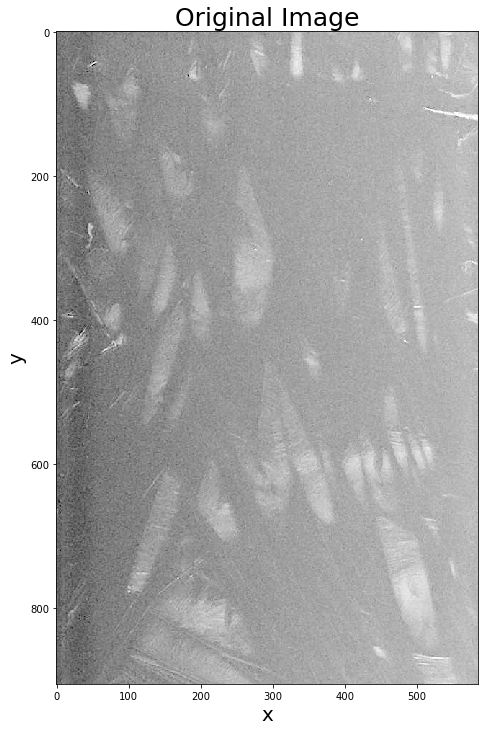

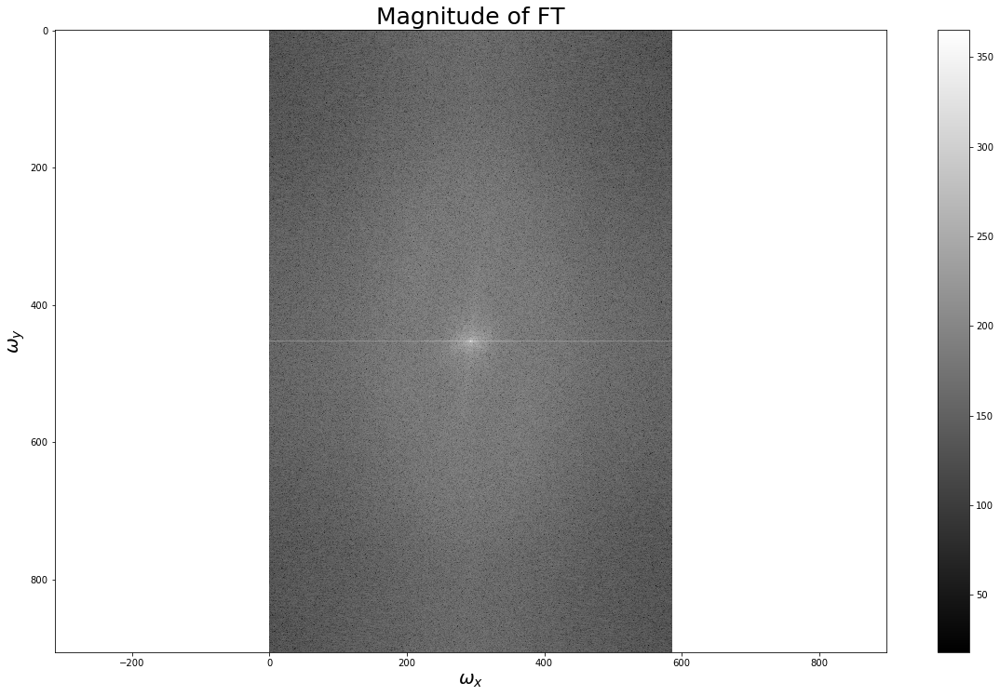

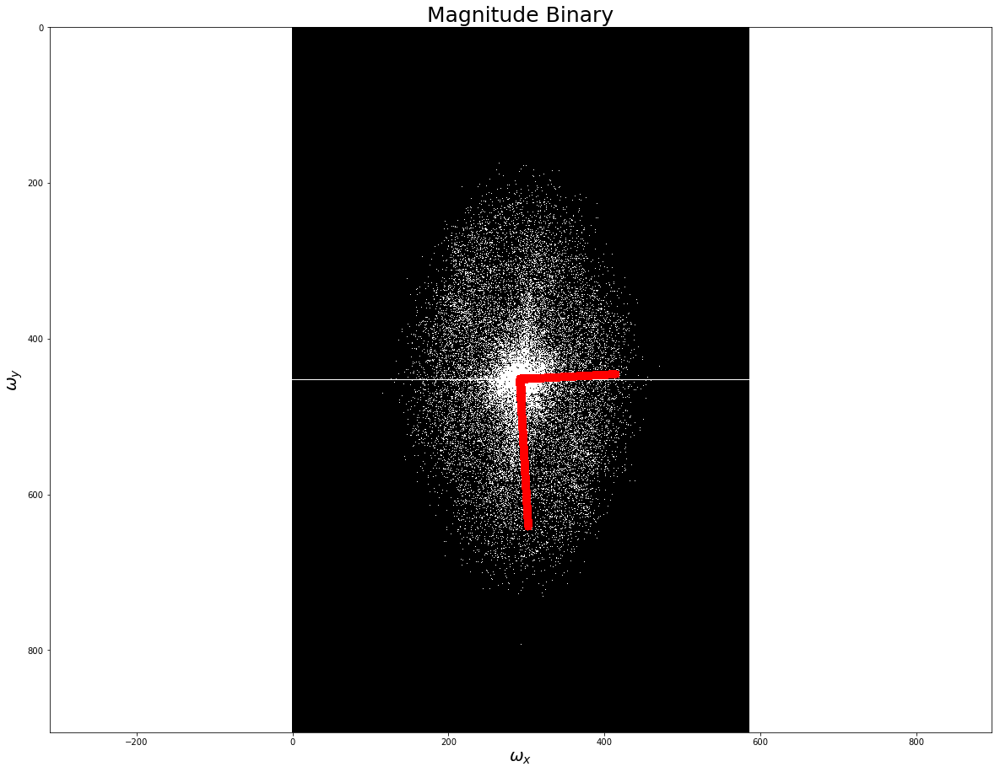

results_discussion/camera_135TCB_CB/135TCB_CB_sample32.jpeg
32


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = 79.484 

The angle between the second component and the horizontal is 
        β = 10.516 

The alignment factor is: 0.706


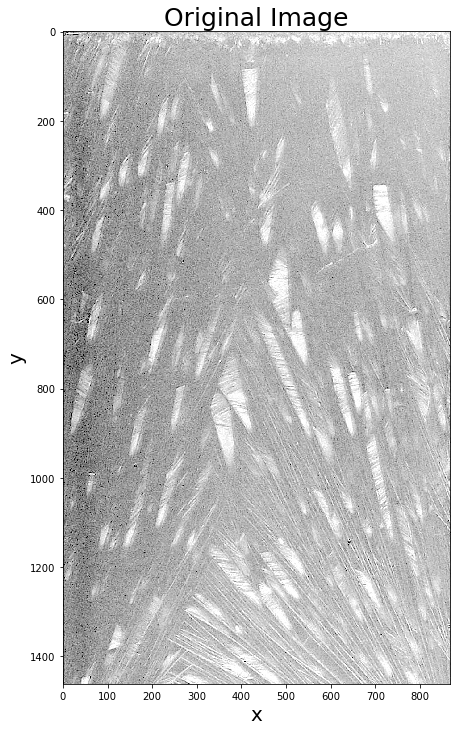

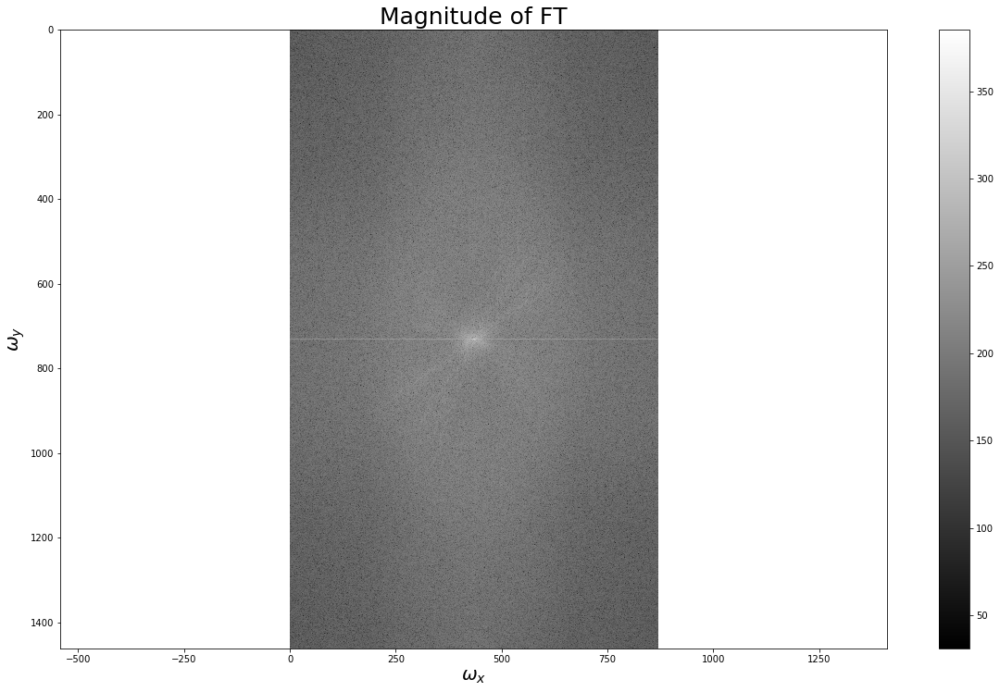

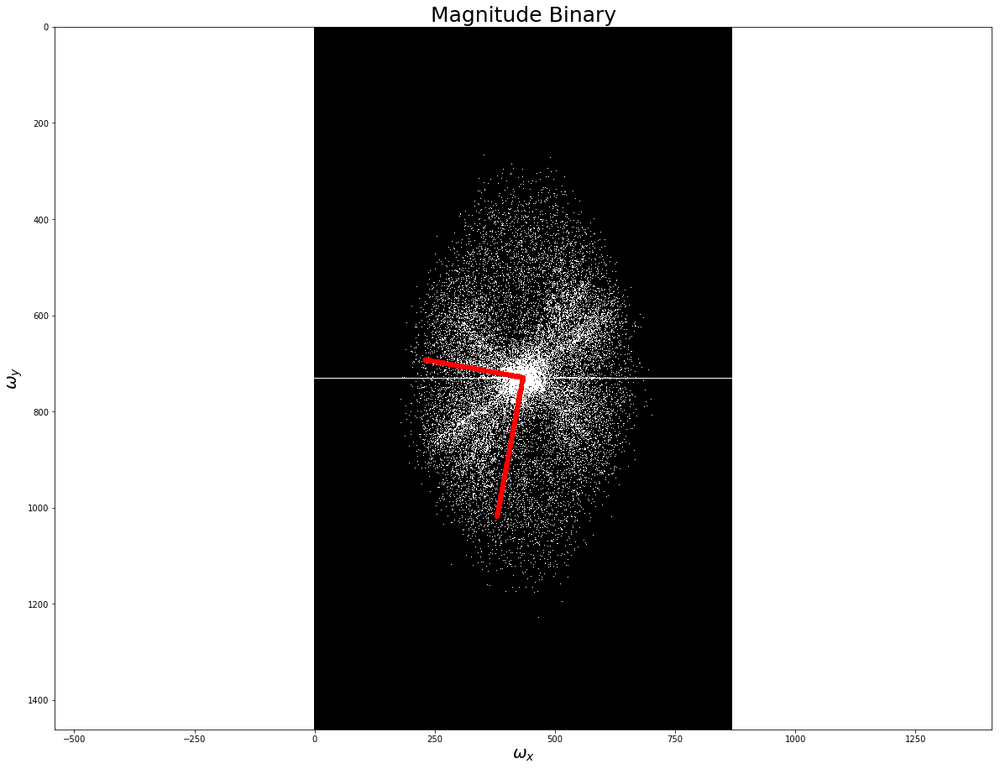

results_discussion/camera_135TCB_CB/135TCB_CB_sample2.jpeg
2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -52.642 

The angle between the second component and the horizontal is 
        β = -37.358 

The alignment factor is: 0.731


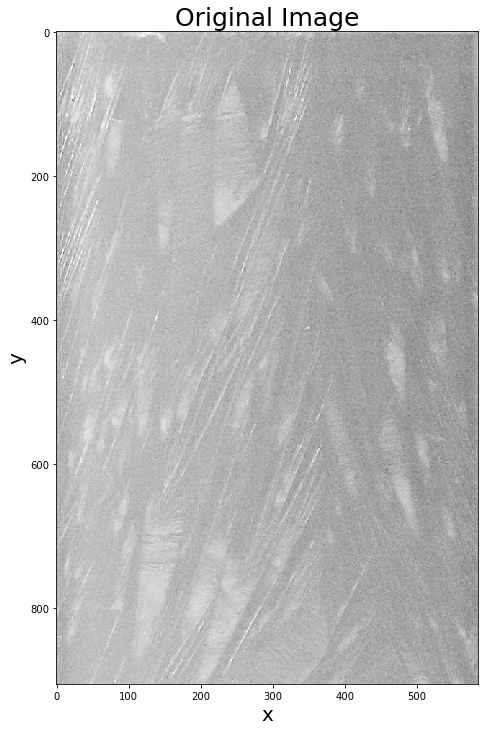

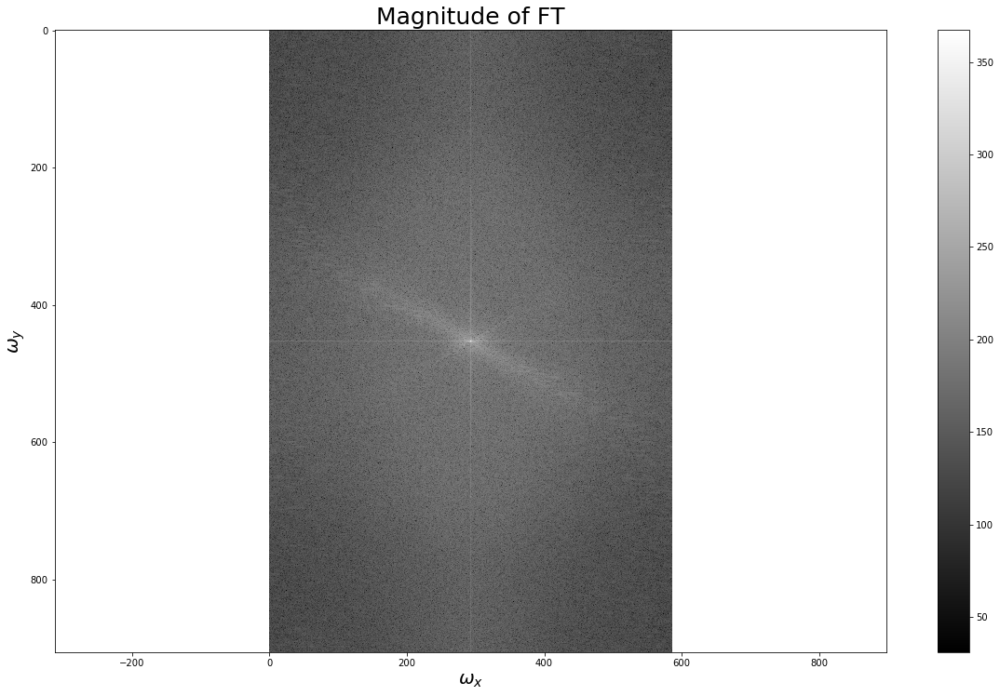

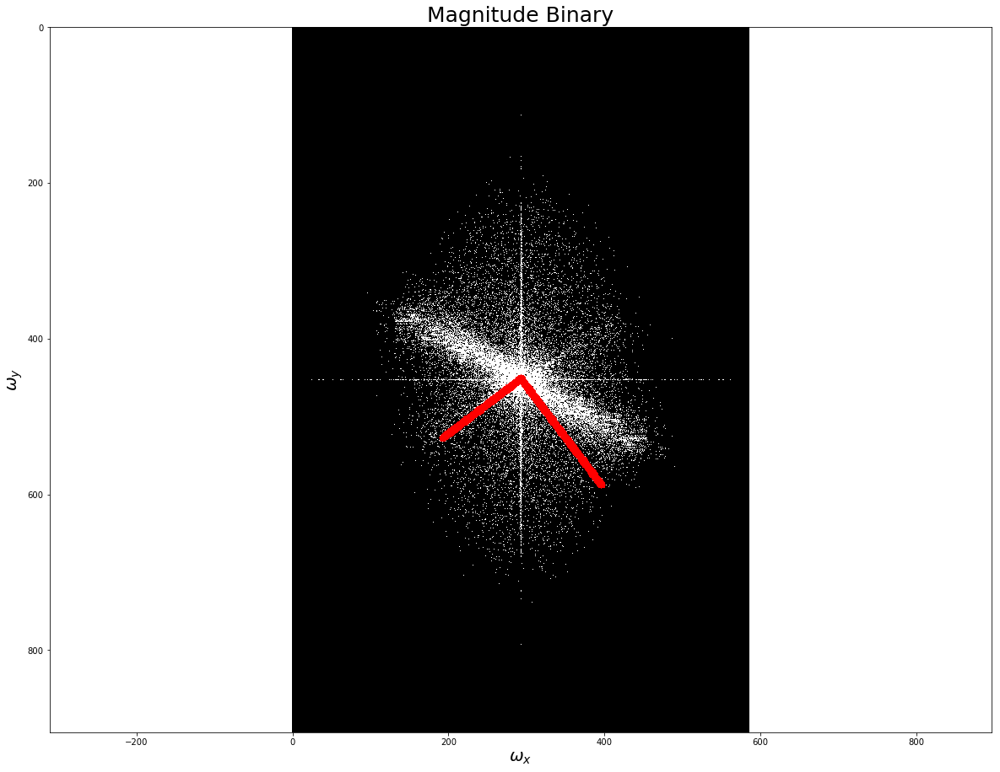

results_discussion/camera_135TCB_CB/135TCB_CB_sample28.jpeg
28


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -87.532 

The angle between the second component and the horizontal is 
        β = -2.468 

The alignment factor is: 0.548


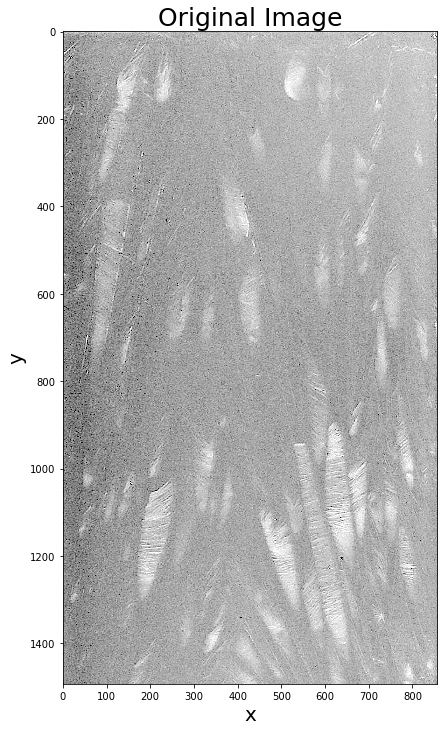

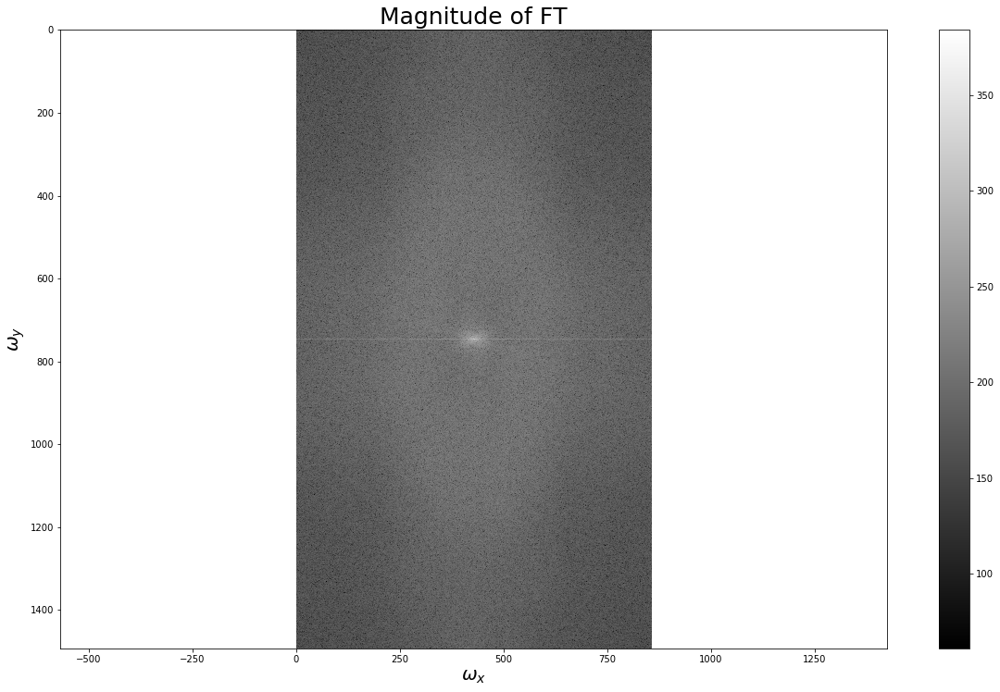

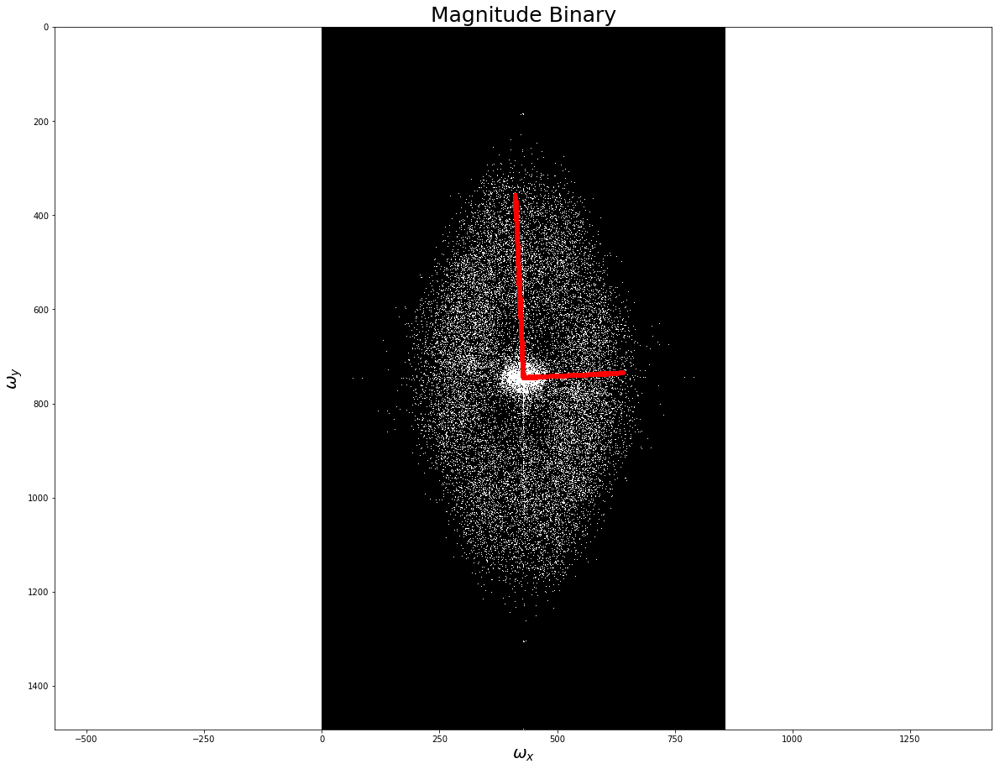

results_discussion/camera_135TCB_CB/135TCB_CB_sample12.jpeg
12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -71.584 

The angle between the second component and the horizontal is 
        β = -18.416 

The alignment factor is: 0.787


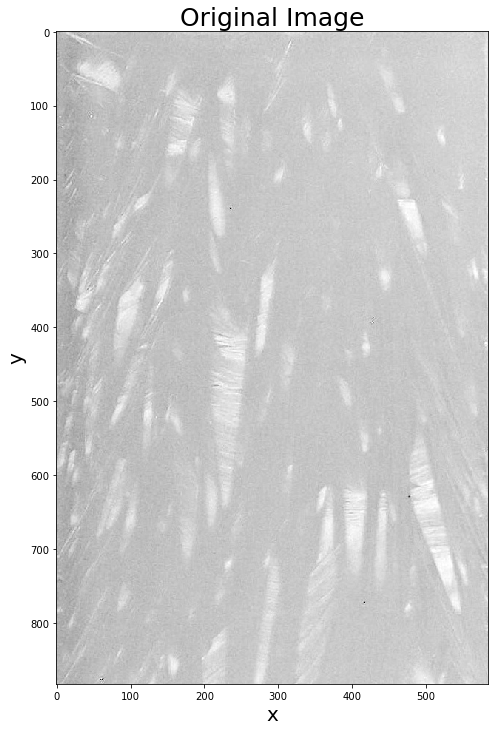

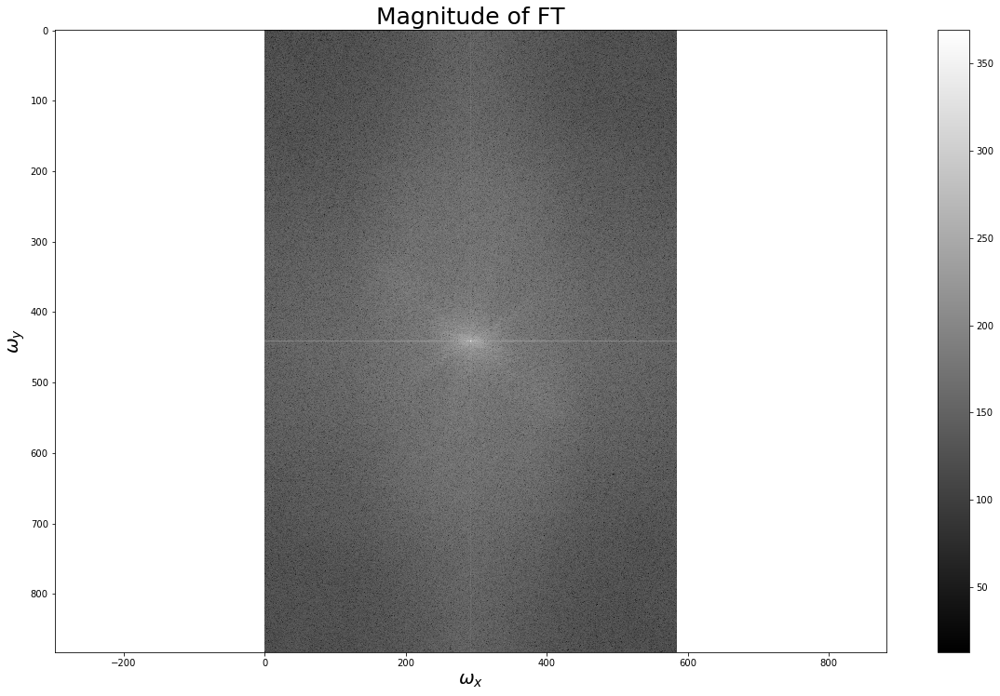

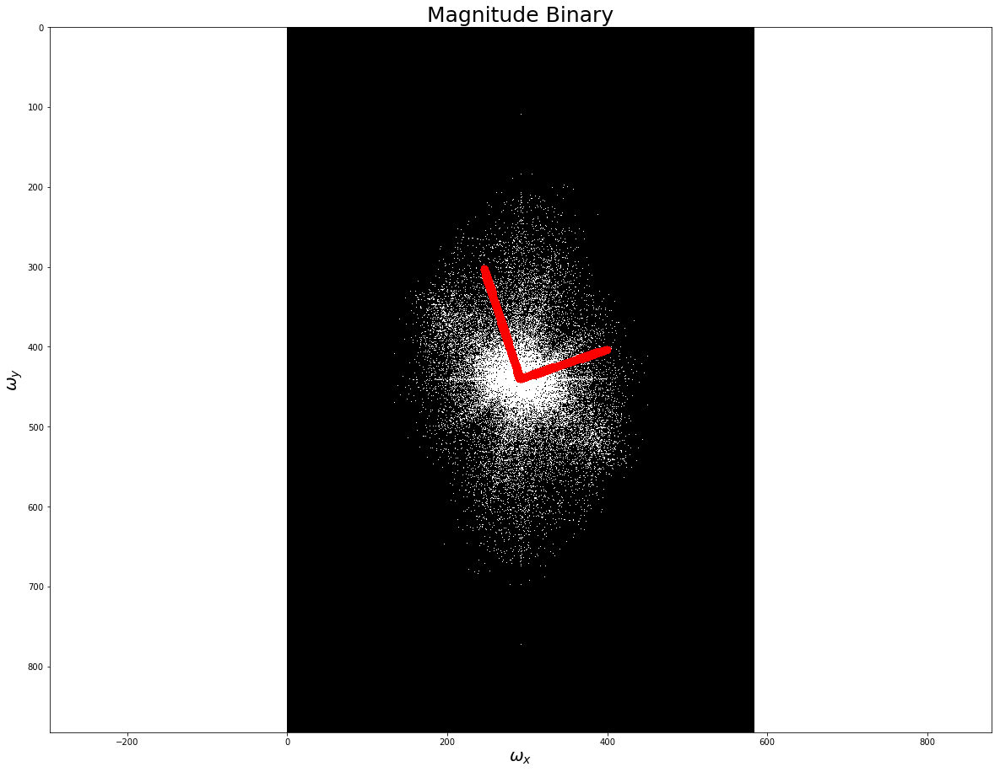

results_discussion/camera_135TCB_CB/135TCB_CB_sample13.jpeg
13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -32.224 

The angle between the second component and the horizontal is 
        β = -57.776 

The alignment factor is: 0.468


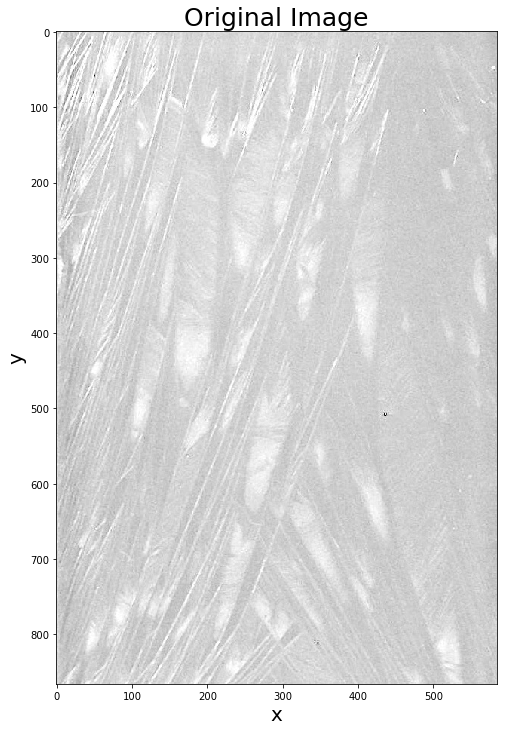

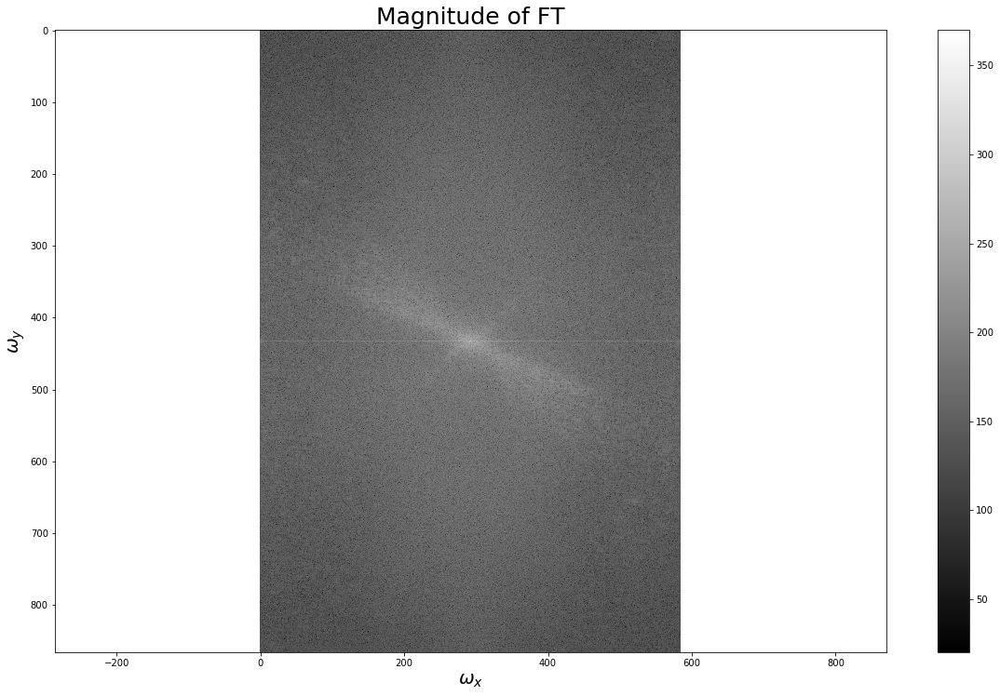

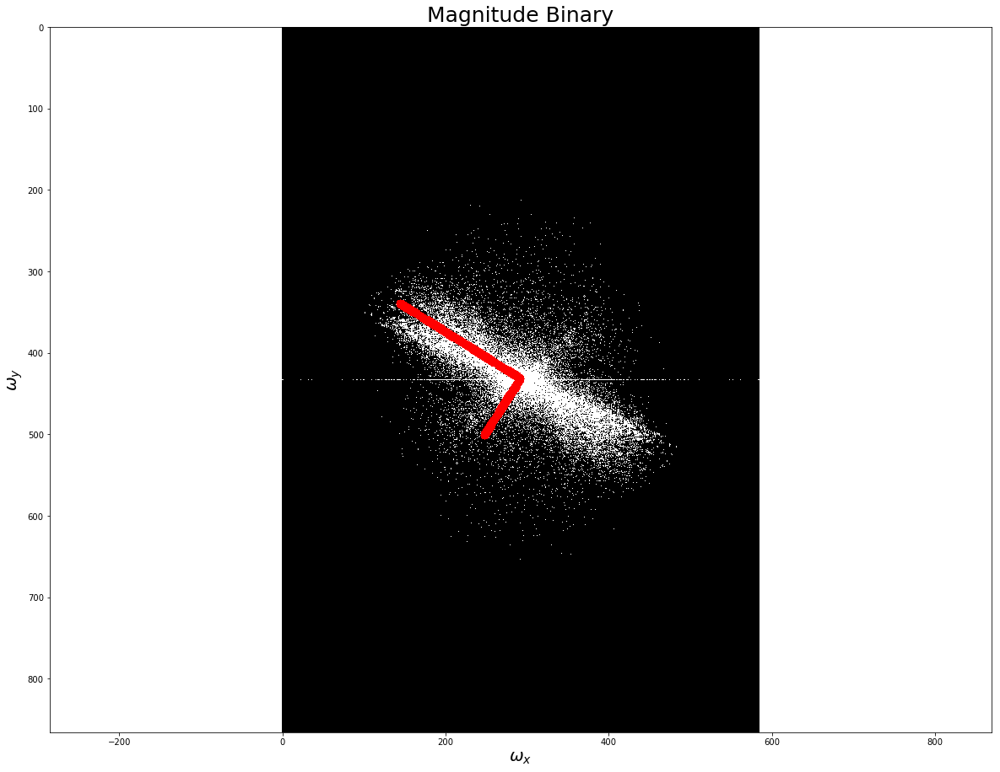

results_discussion/camera_135TCB_CB/135TCB_CB_sample29.jpeg
29


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -74.840 

The angle between the second component and the horizontal is 
        β = -15.160 

The alignment factor is: 0.51


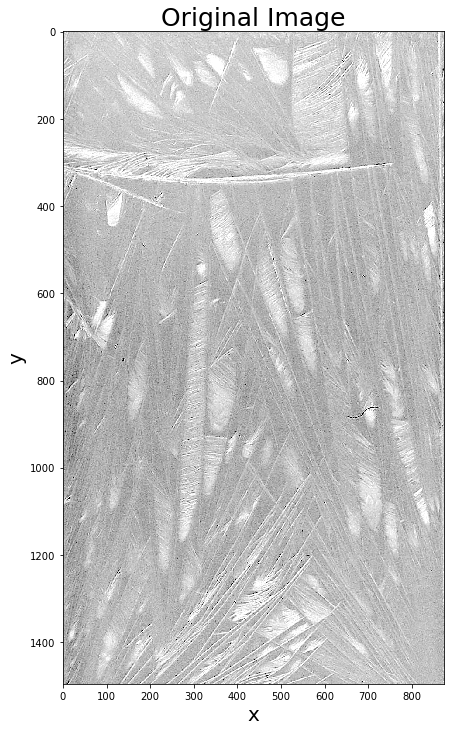

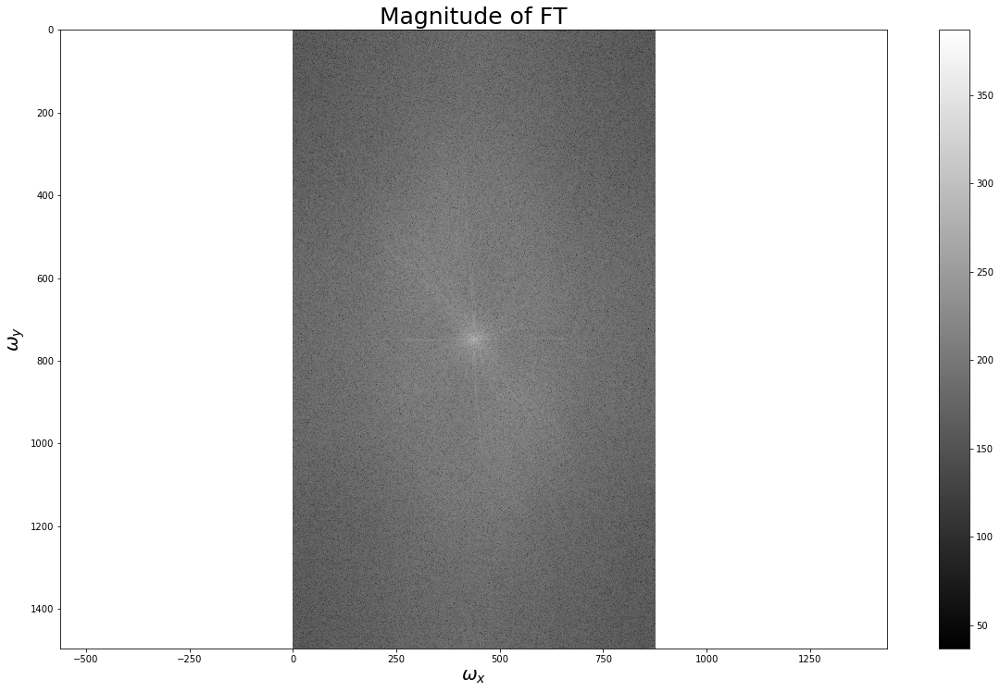

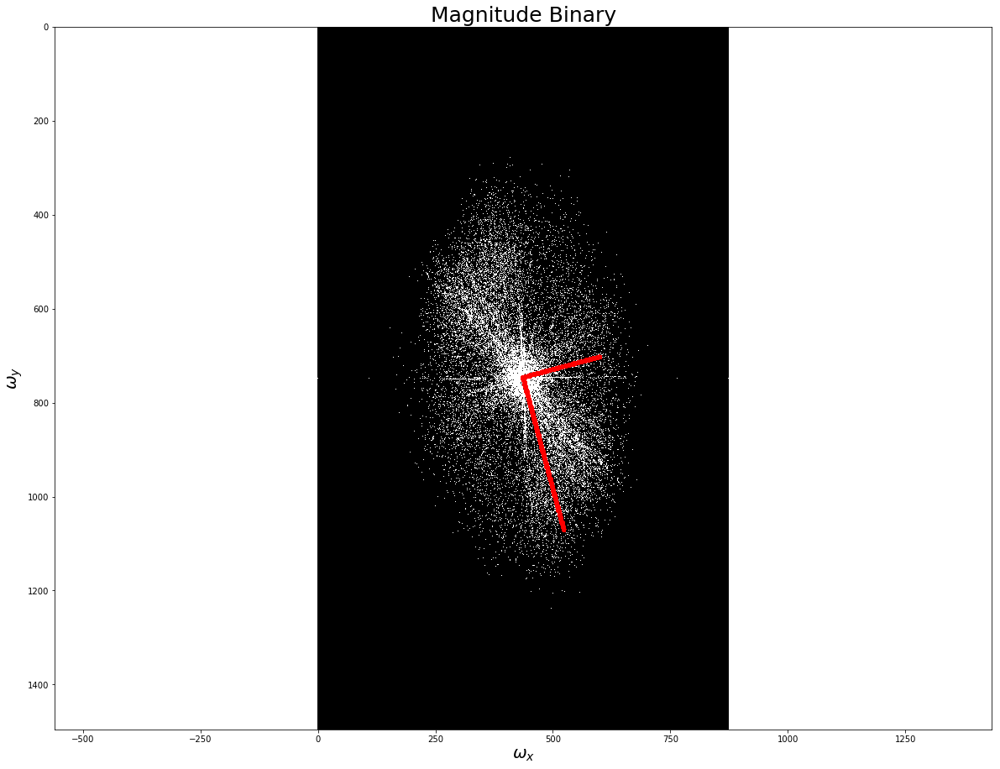

results_discussion/camera_135TCB_CB/135TCB_CB_sample3.jpeg
3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -46.537 

The angle between the second component and the horizontal is 
        β = -43.463 

The alignment factor is: 0.327


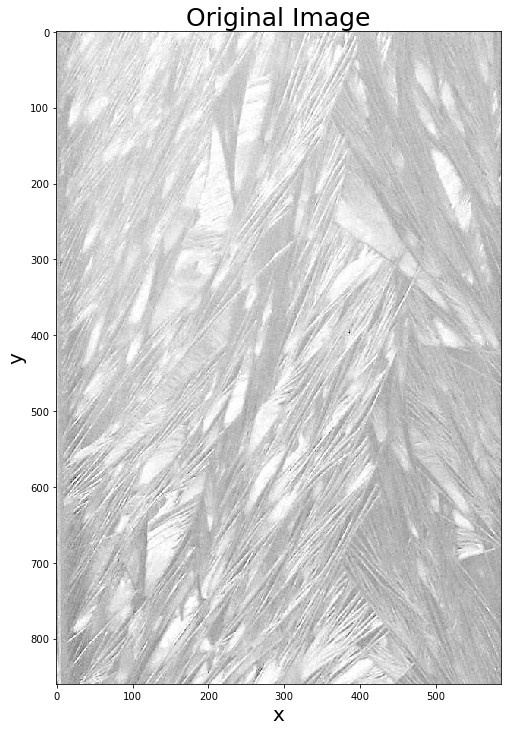

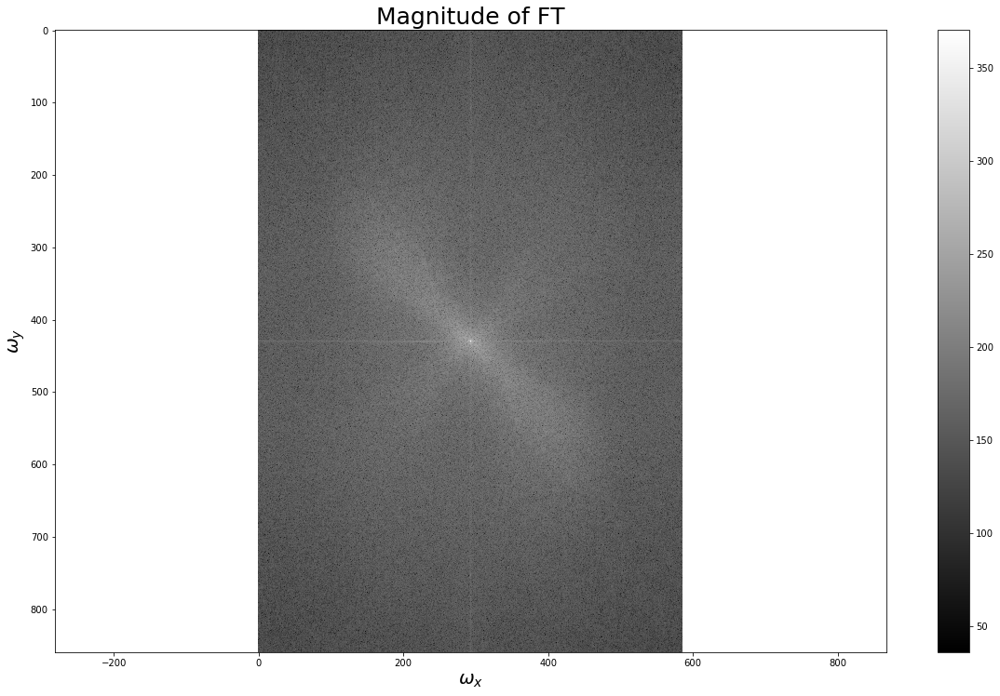

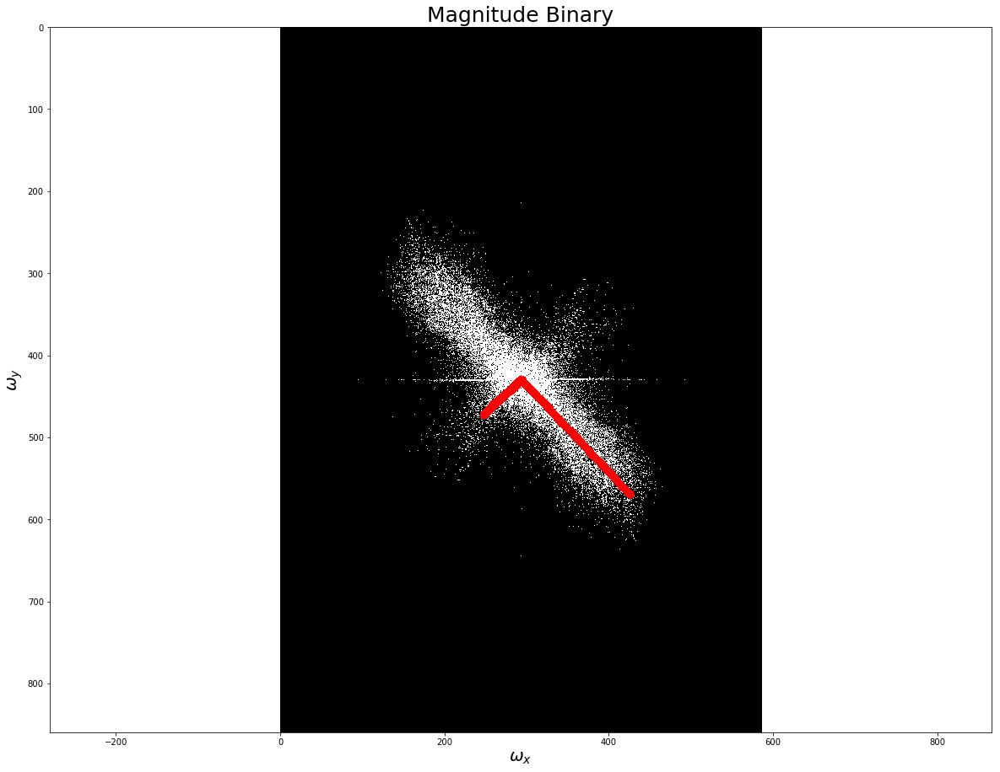

results_discussion/camera_135TCB_CB/135TCB_CB_sample33.jpeg
33


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -53.907 

The angle between the second component and the horizontal is 
        β = -36.093 

The alignment factor is: 0.727


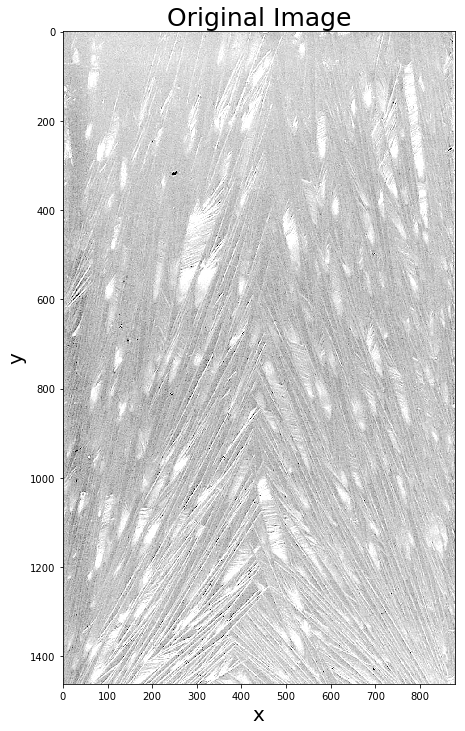

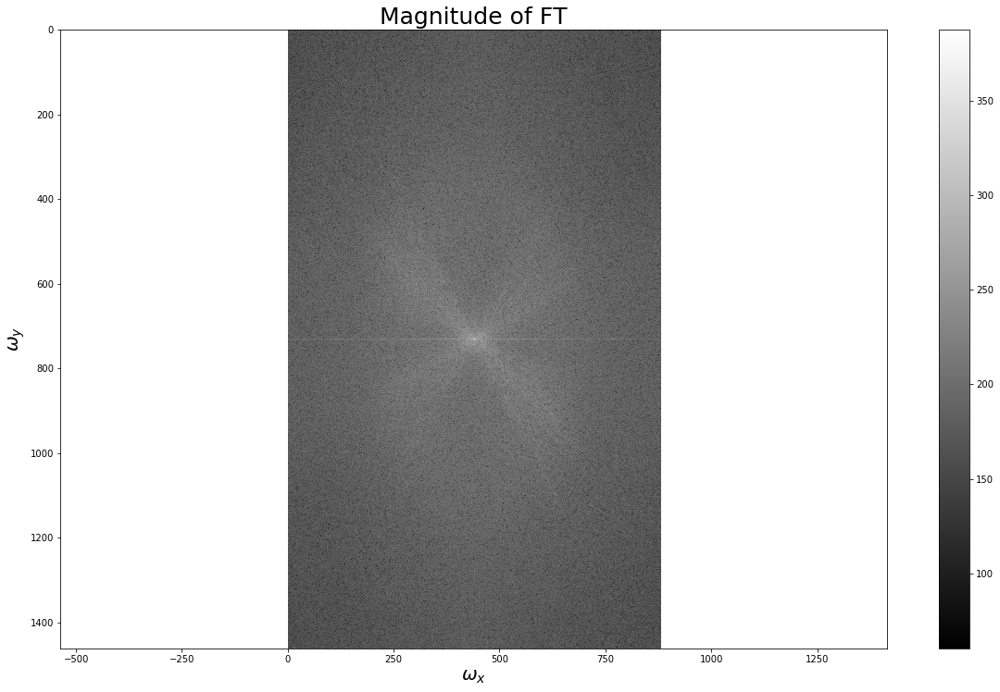

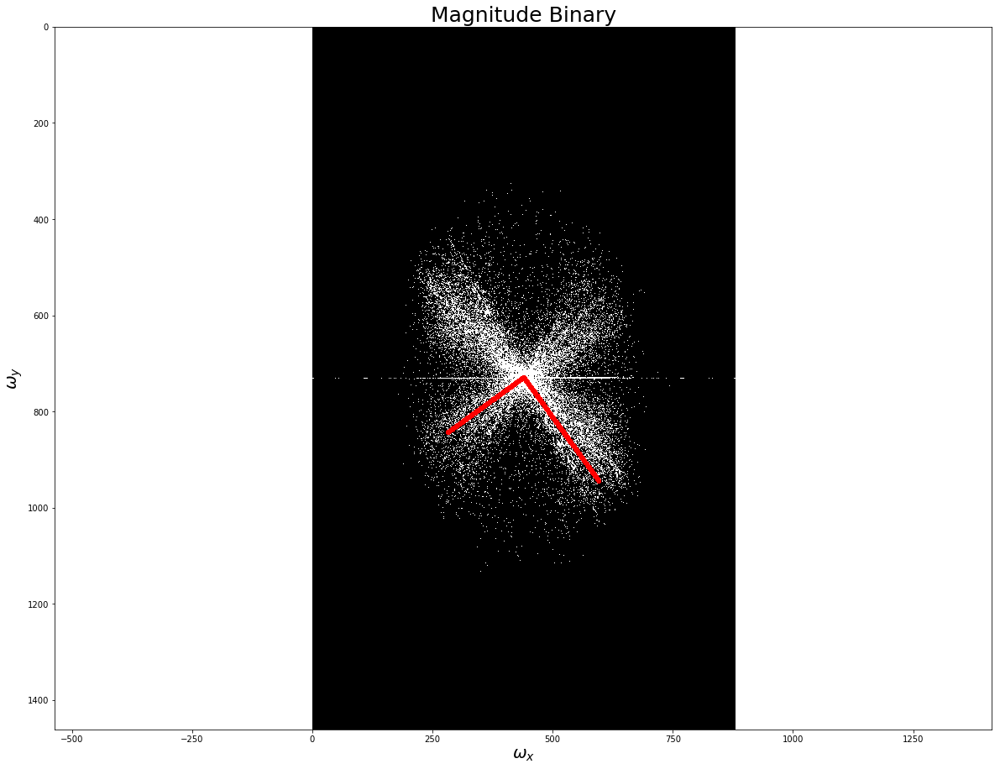

results_discussion/camera_135TCB_CB/135TCB_CB_sample25.jpeg
25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -84.199 

The angle between the second component and the horizontal is 
        β = -5.801 

The alignment factor is: 0.503


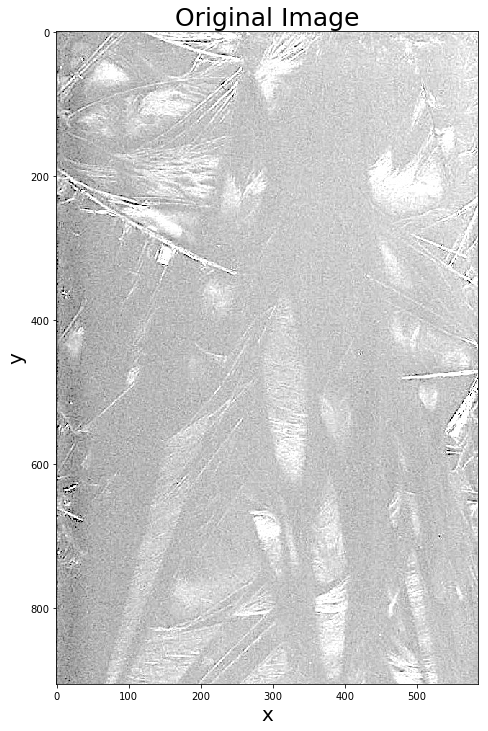

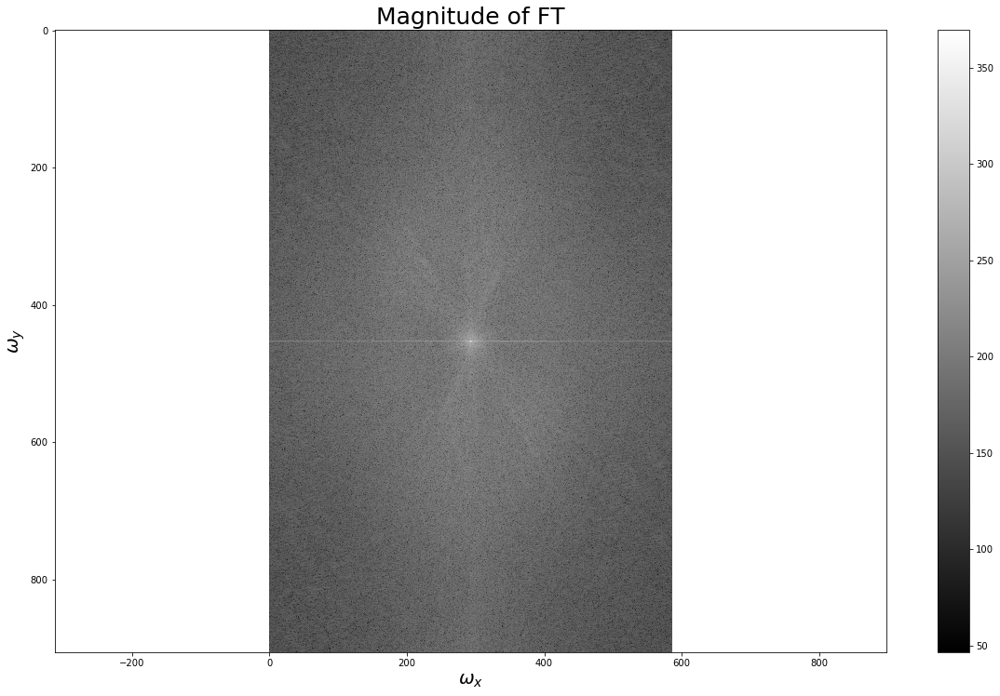

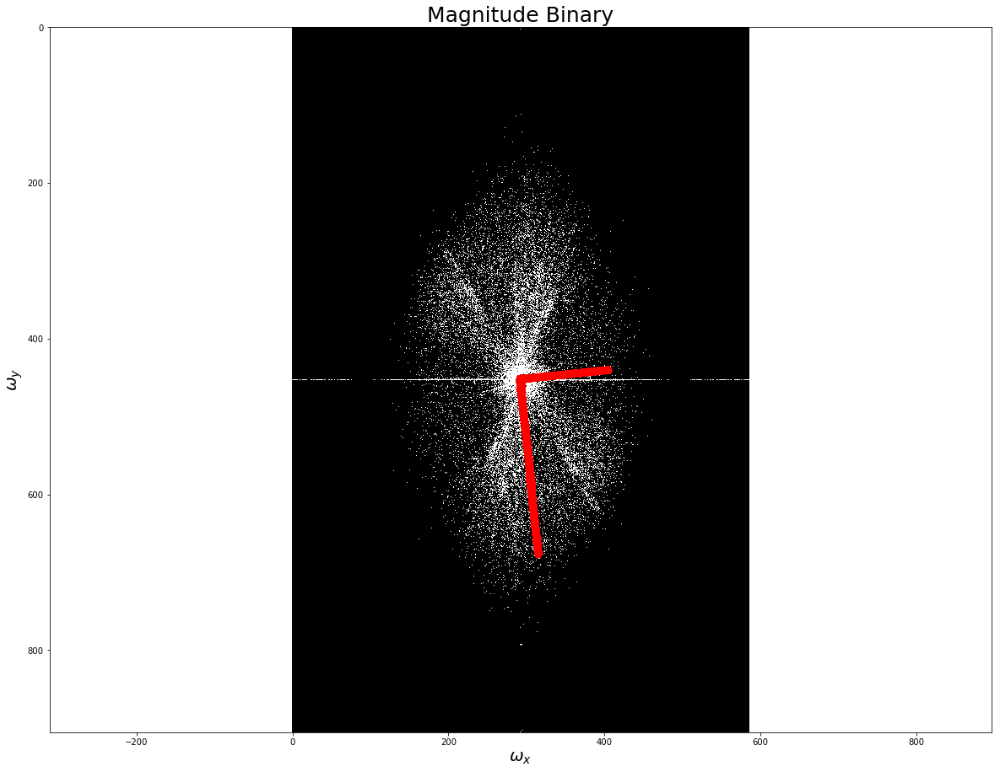

results_discussion/camera_135TCB_CB/135TCB_CB_sample8.jpeg
8


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -24.659 

The angle between the second component and the horizontal is 
        β = -65.341 

The alignment factor is: 0.73


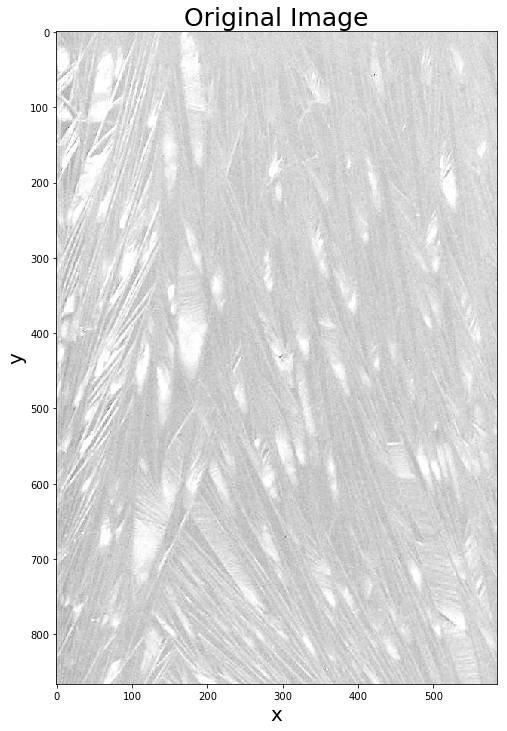

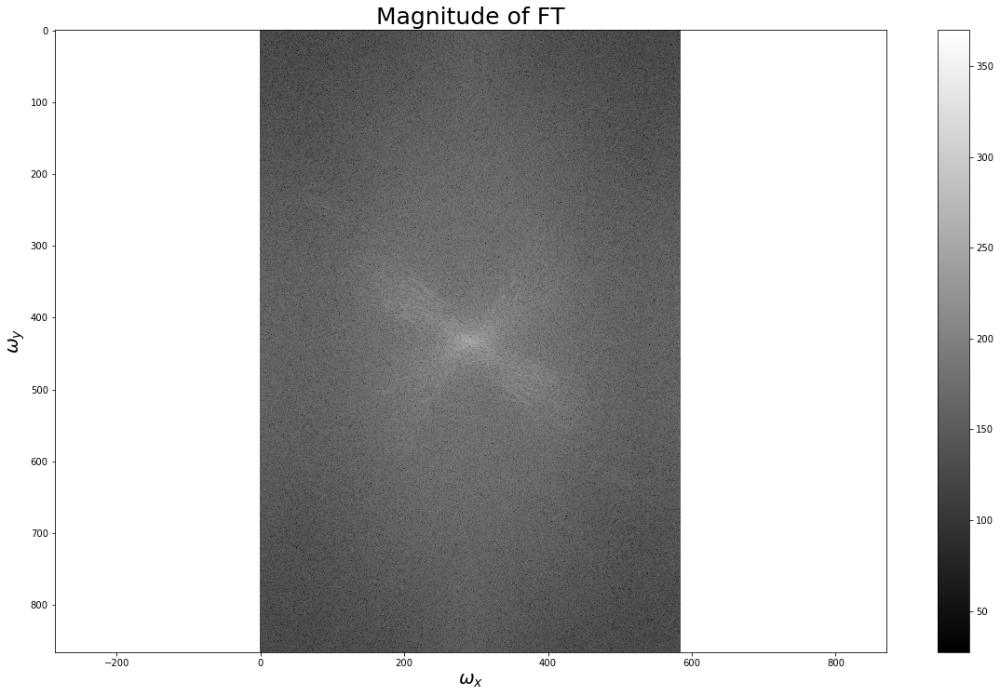

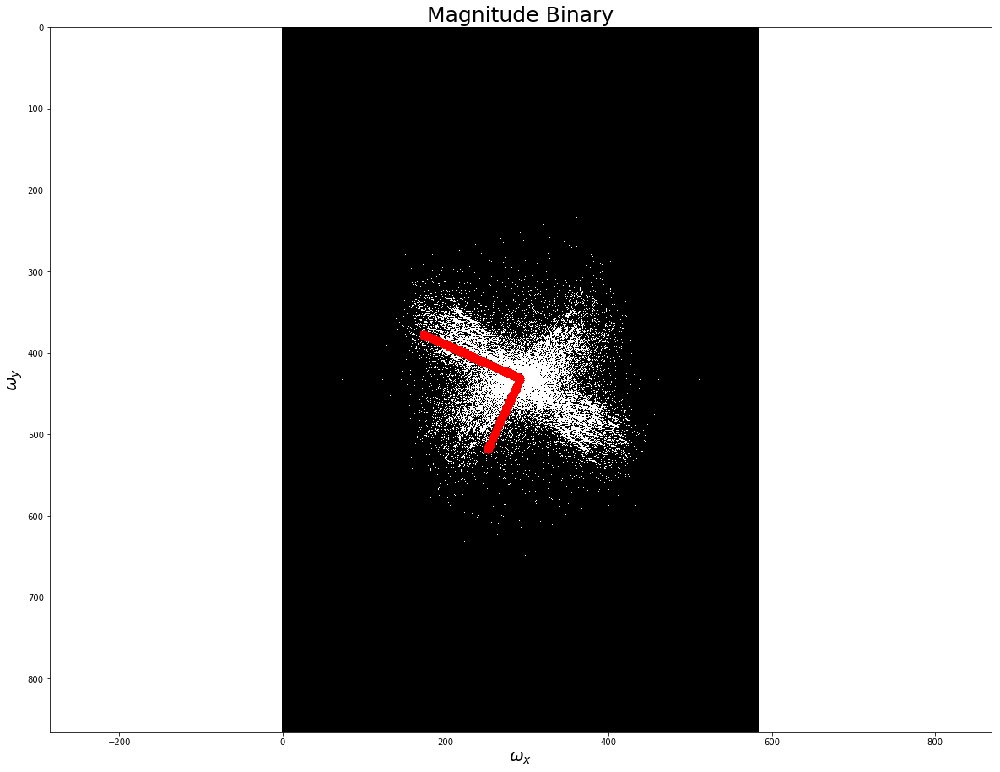

results_discussion/camera_135TCB_CB/135TCB_CB_sample14.jpeg
14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -58.298 

The angle between the second component and the horizontal is 
        β = -31.702 

The alignment factor is: 0.799


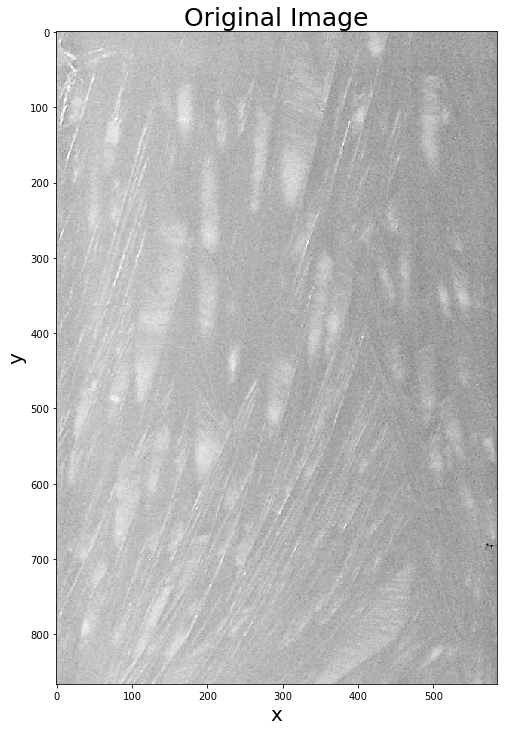

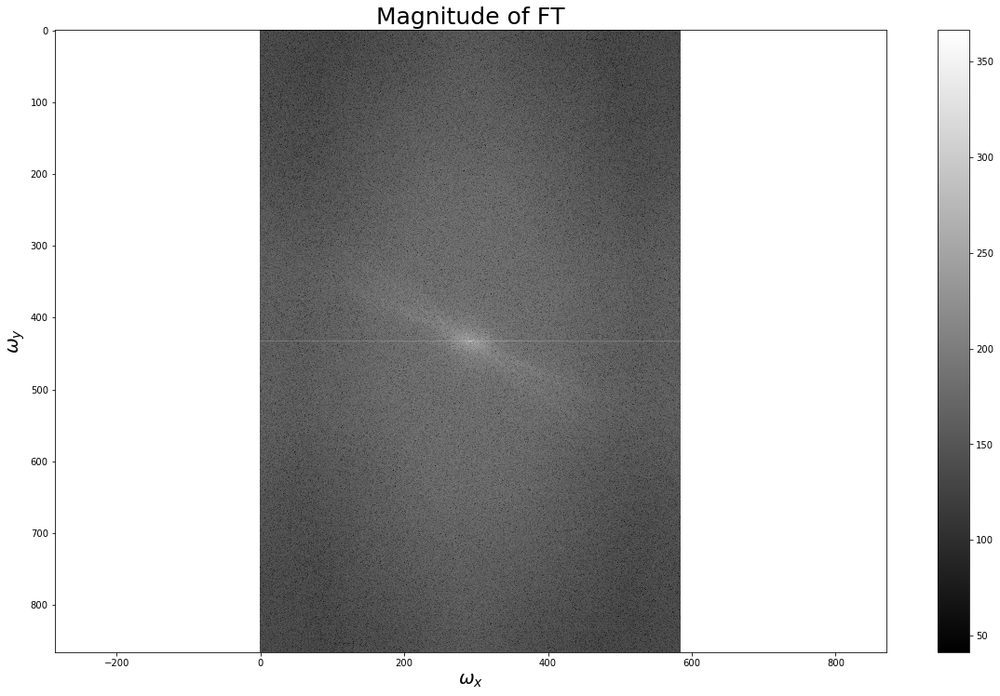

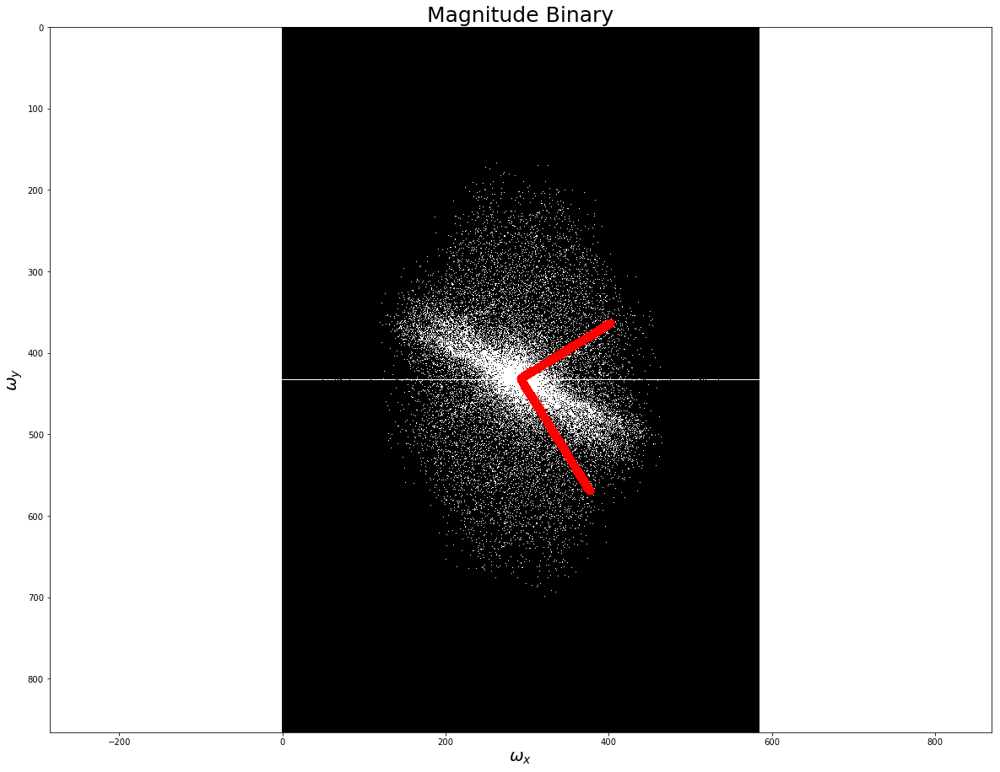

results_discussion/camera_135TCB_CB/135TCB_CB_sample22.jpeg
22


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -65.865 

The angle between the second component and the horizontal is 
        β = -24.135 

The alignment factor is: 0.685


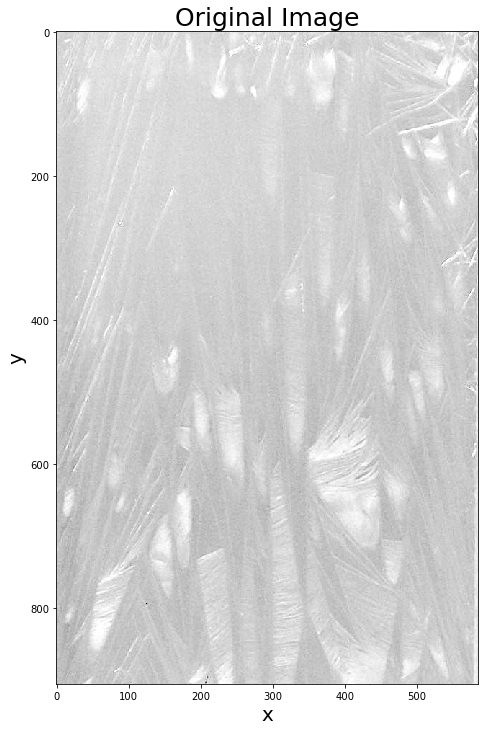

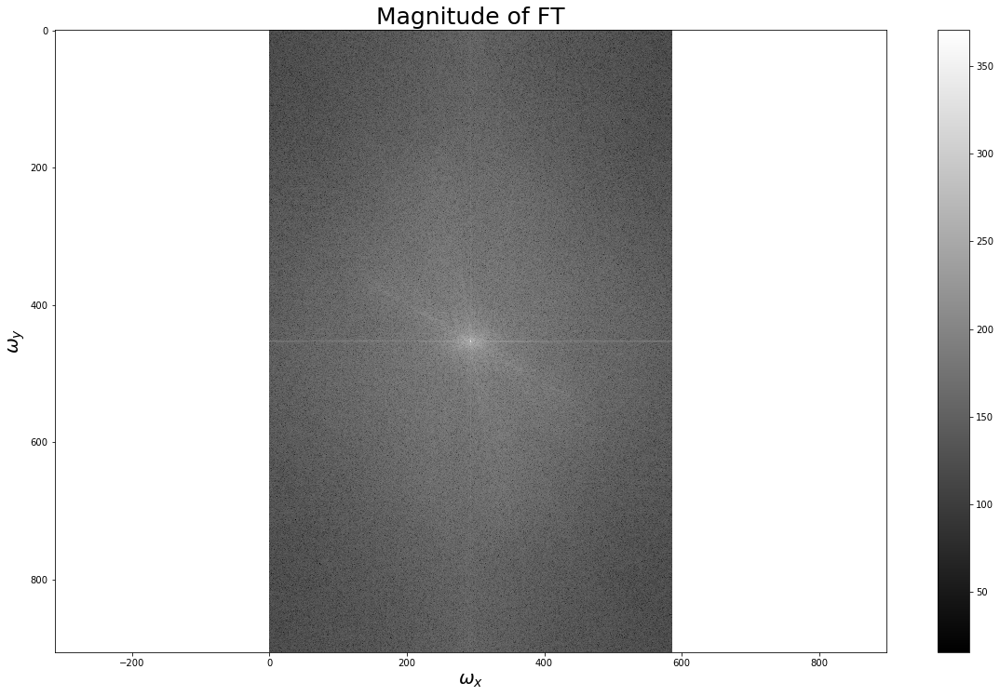

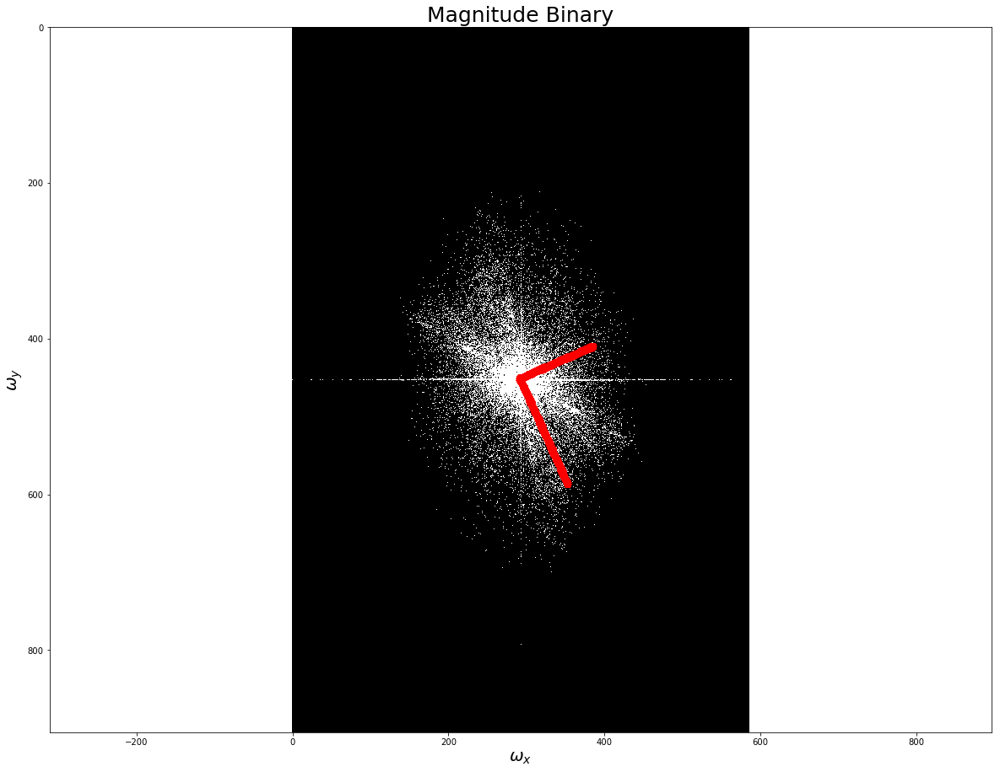

results_discussion/camera_135TCB_CB/135TCB_CB_sample4.jpeg
4


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -39.228 

The angle between the second component and the horizontal is 
        β = -50.772 

The alignment factor is: 0.343


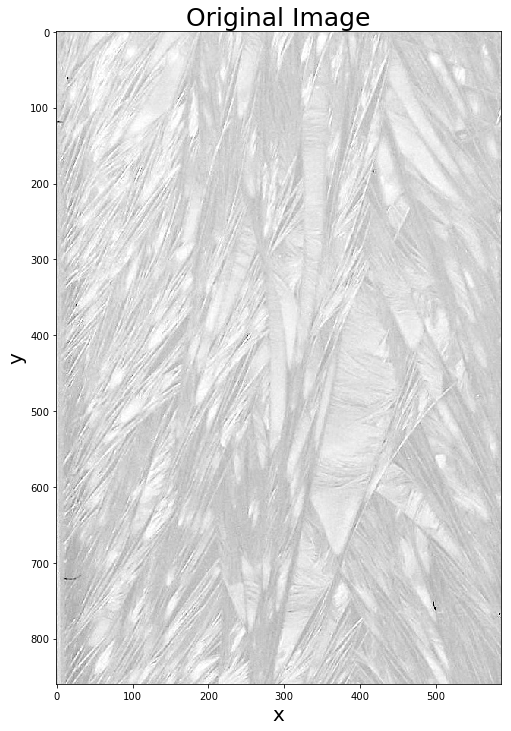

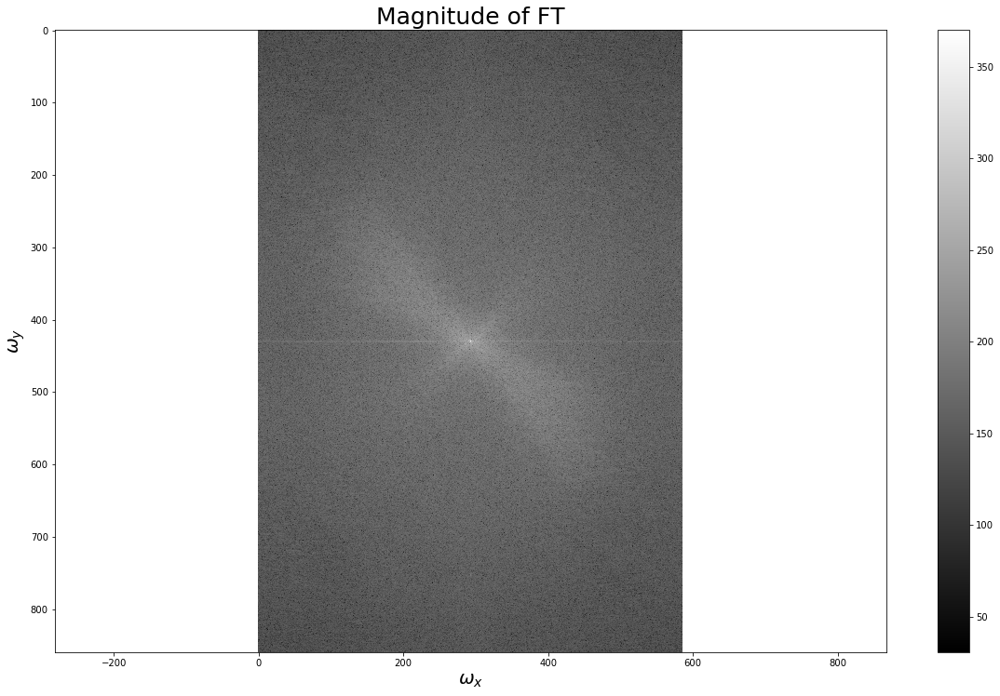

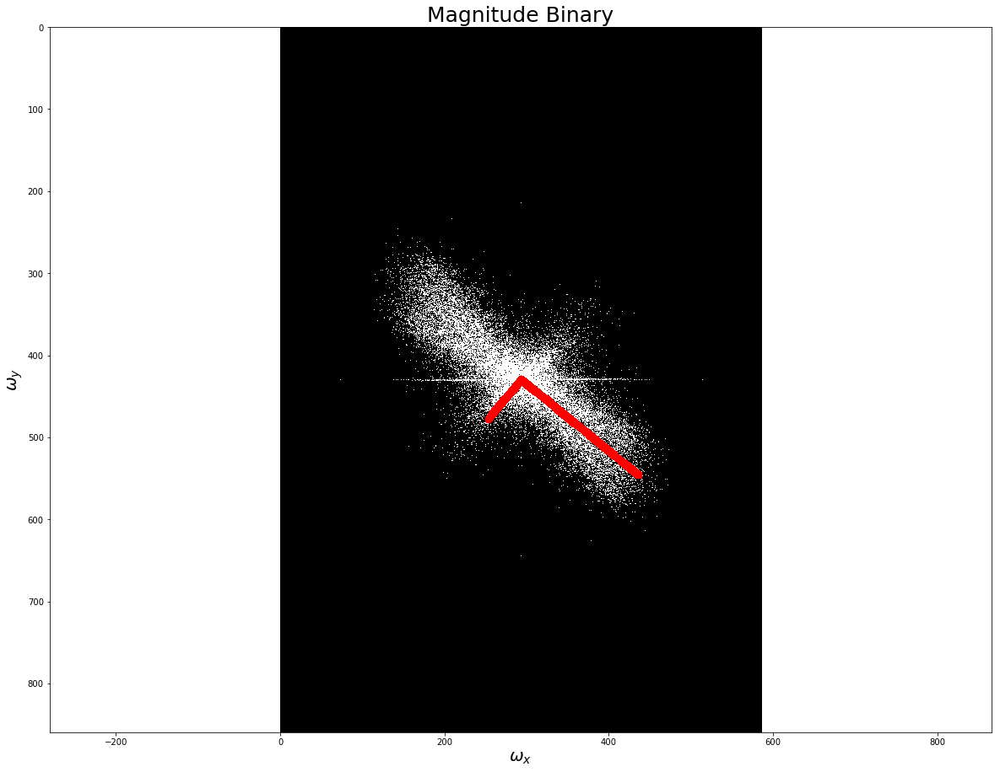

results_discussion/camera_135TCB_CB/135TCB_CB_sample18.jpeg
18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = 69.241 

The angle between the second component and the horizontal is 
        β = 20.759 

The alignment factor is: 0.694


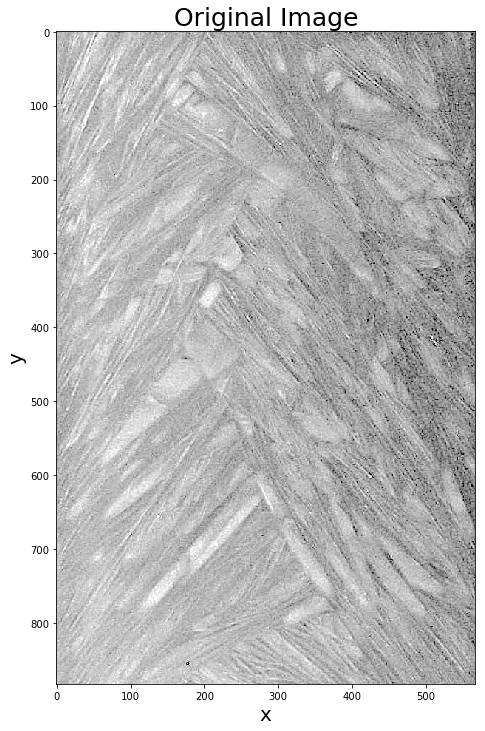

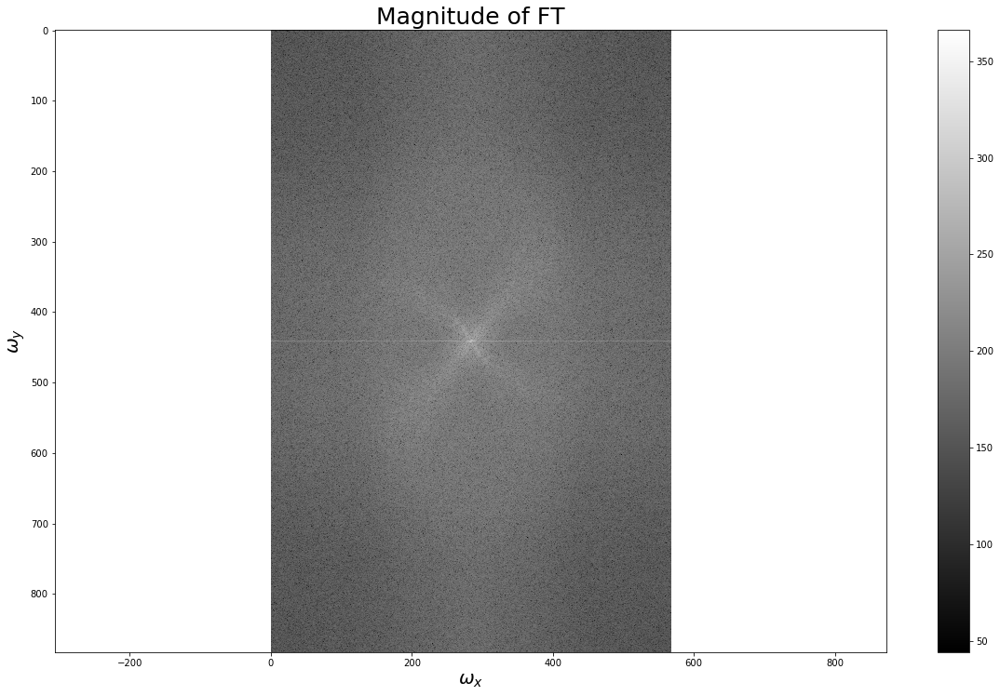

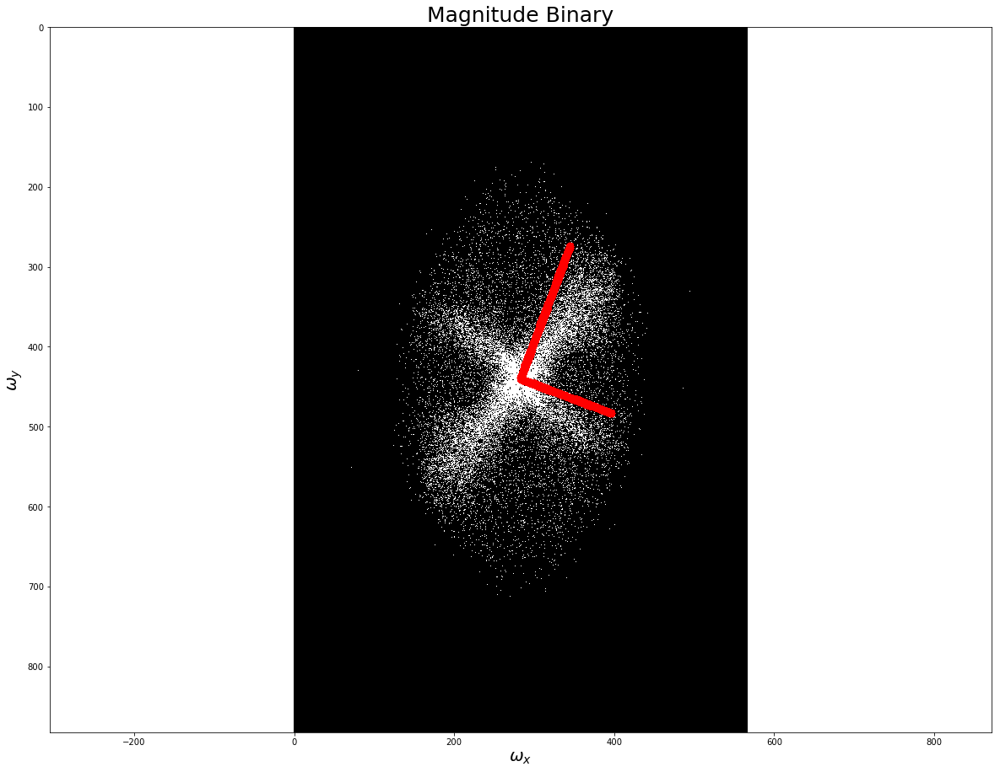

results_discussion/camera_135TCB_CB/135TCB_CB_sample5.jpeg
5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -41.025 

The angle between the second component and the horizontal is 
        β = -48.975 

The alignment factor is: 0.412


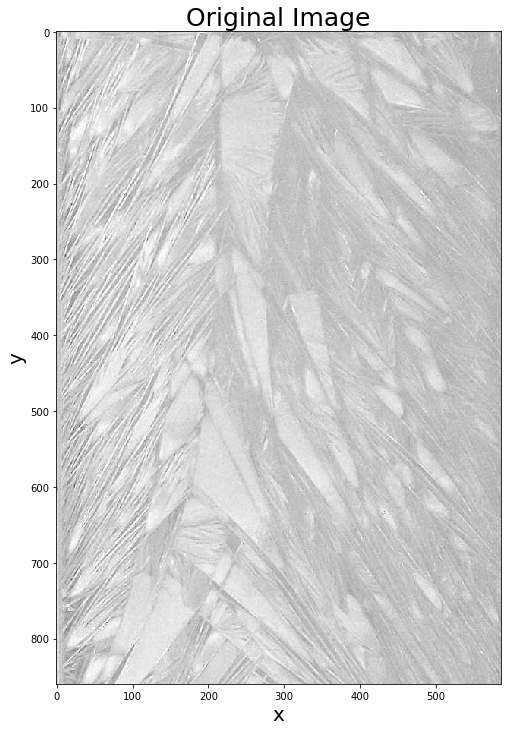

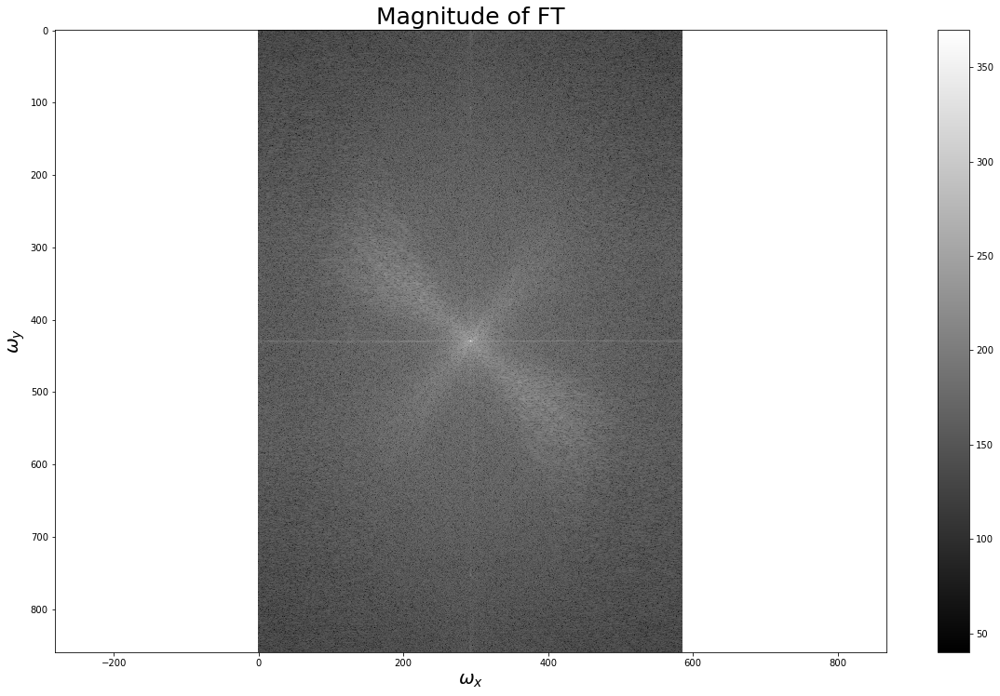

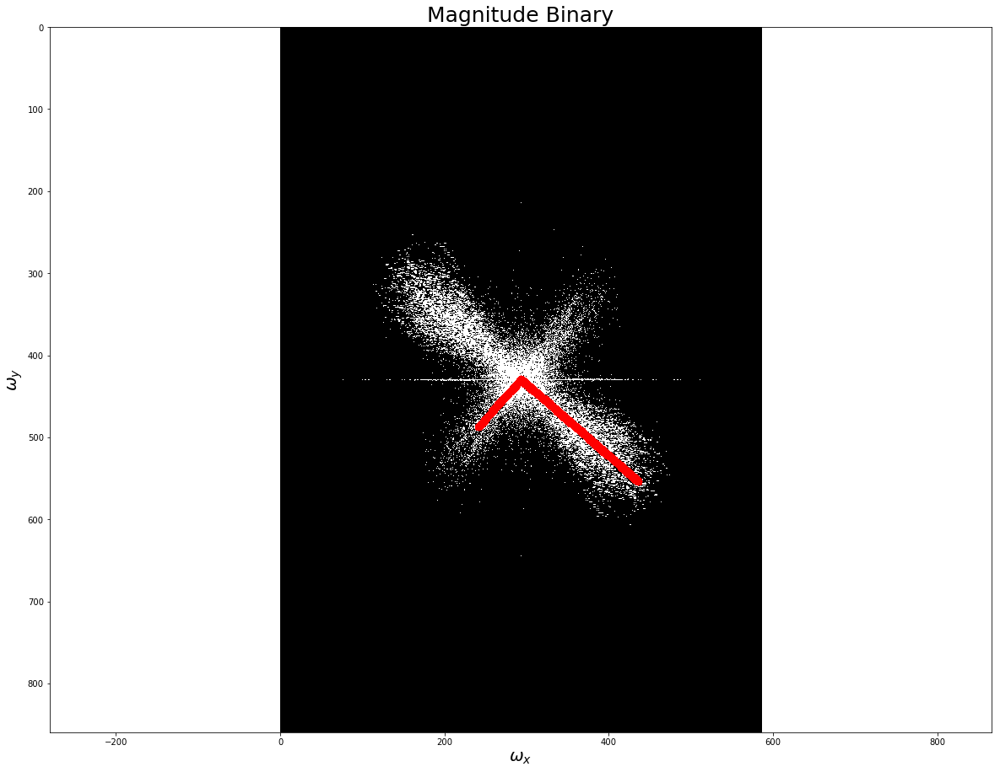

results_discussion/camera_135TCB_CB/135TCB_CB_sample23.jpeg
23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -48.445 

The angle between the second component and the horizontal is 
        β = -41.555 

The alignment factor is: 0.596


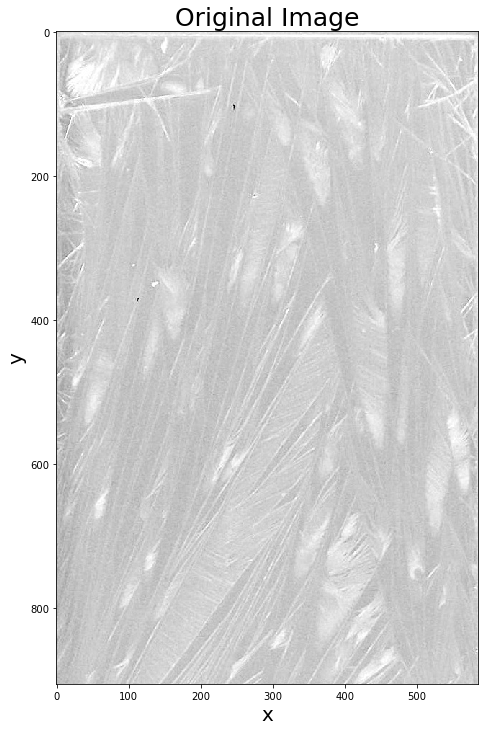

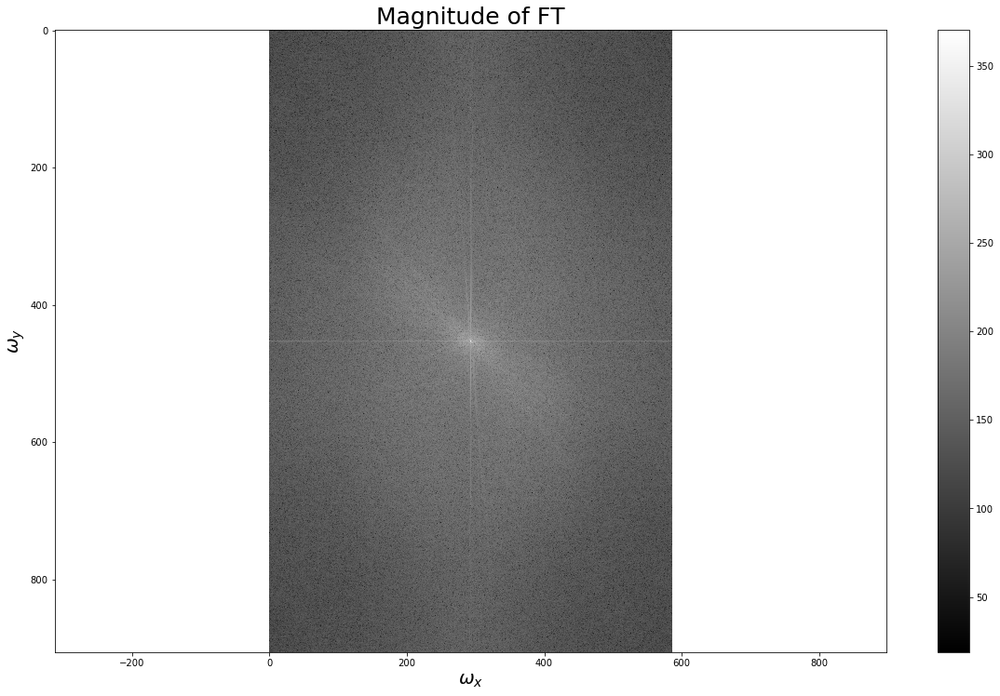

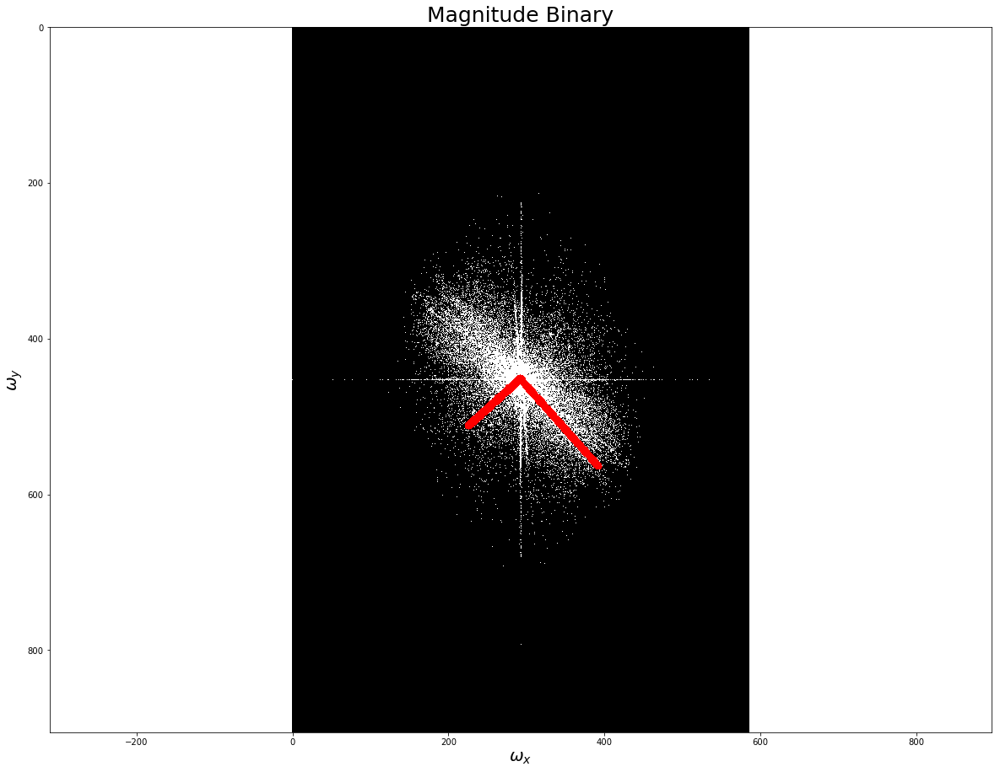

results_discussion/camera_135TCB_CB/135TCB_CB_sample15.jpeg
15


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -52.074 

The angle between the second component and the horizontal is 
        β = -37.926 

The alignment factor is: 0.687


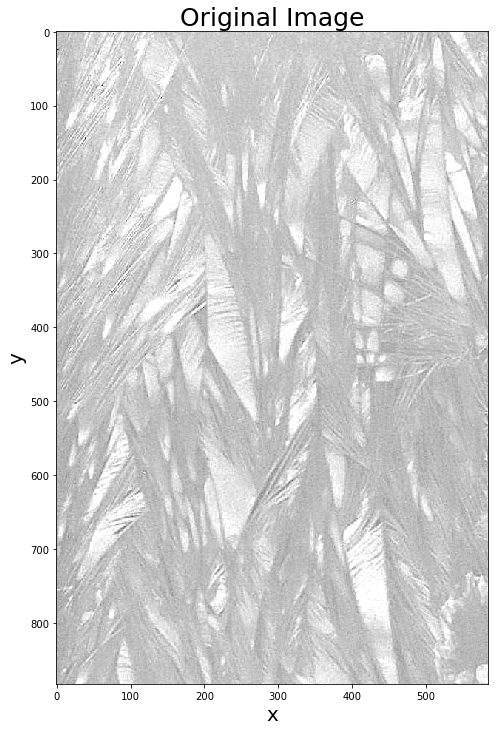

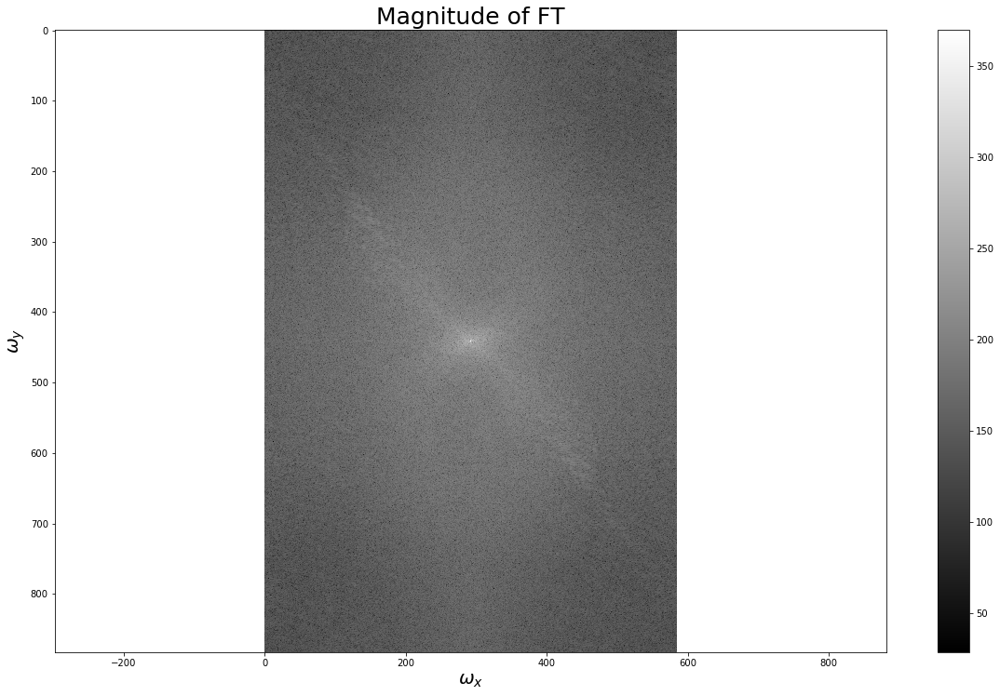

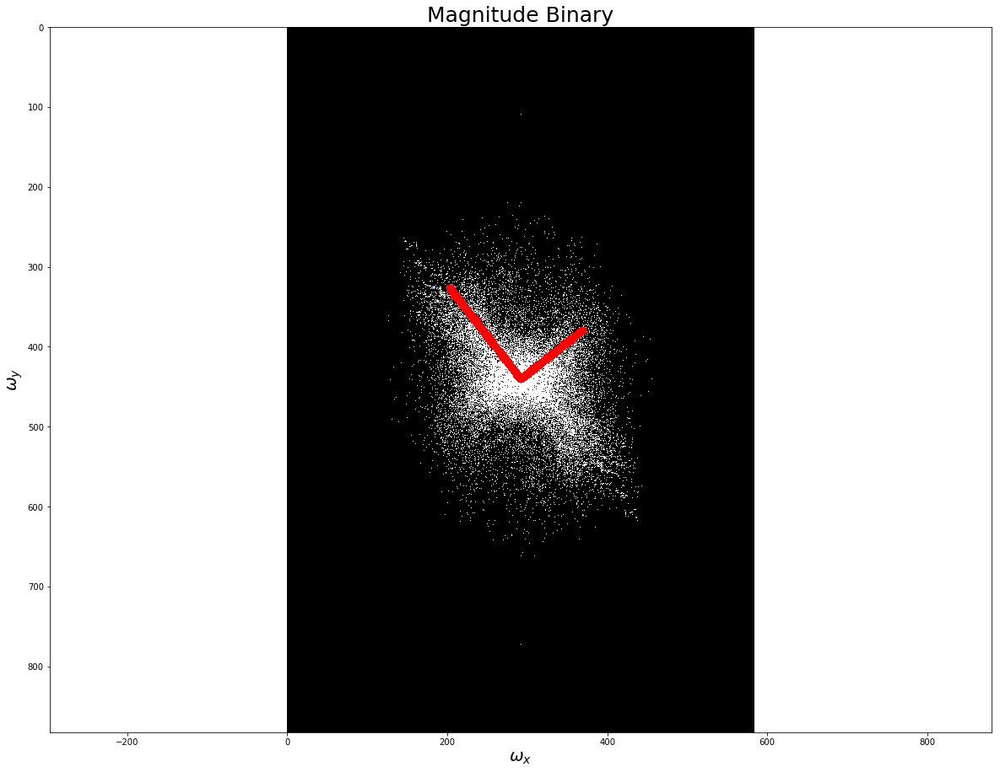

results_discussion/camera_135TCB_CB/135TCB_CB_sample9.jpeg
9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -26.054 

The angle between the second component and the horizontal is 
        β = -63.946 

The alignment factor is: 0.603


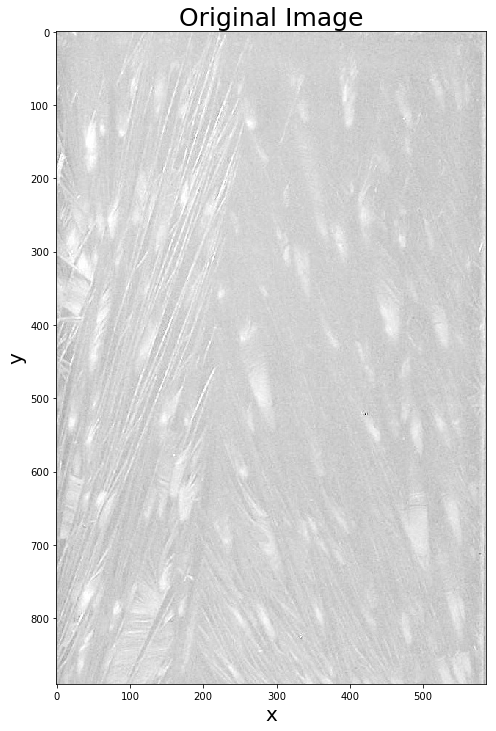

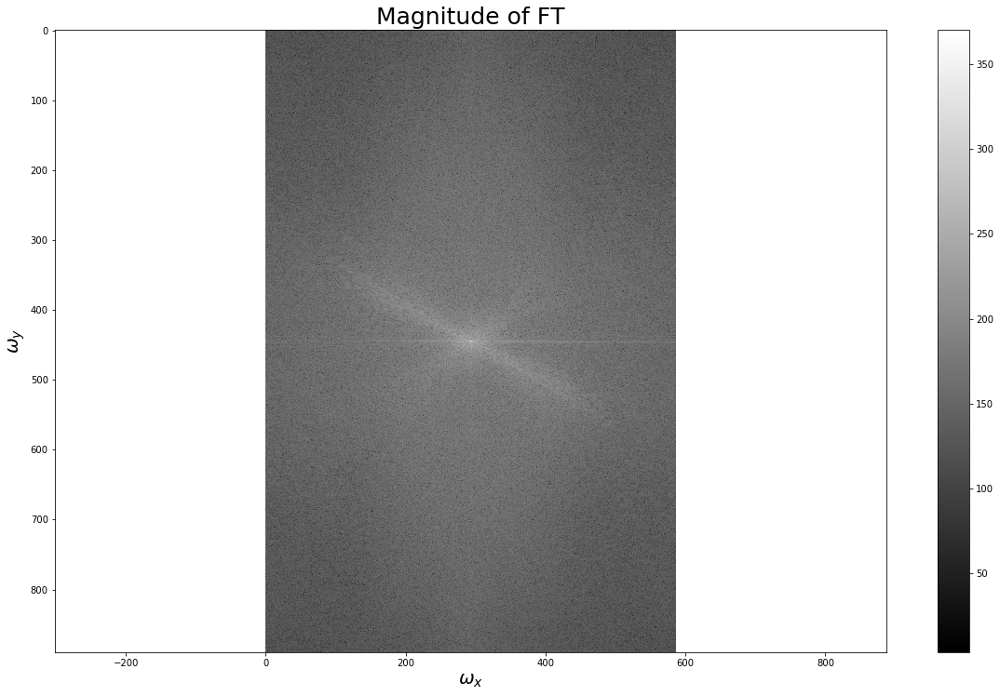

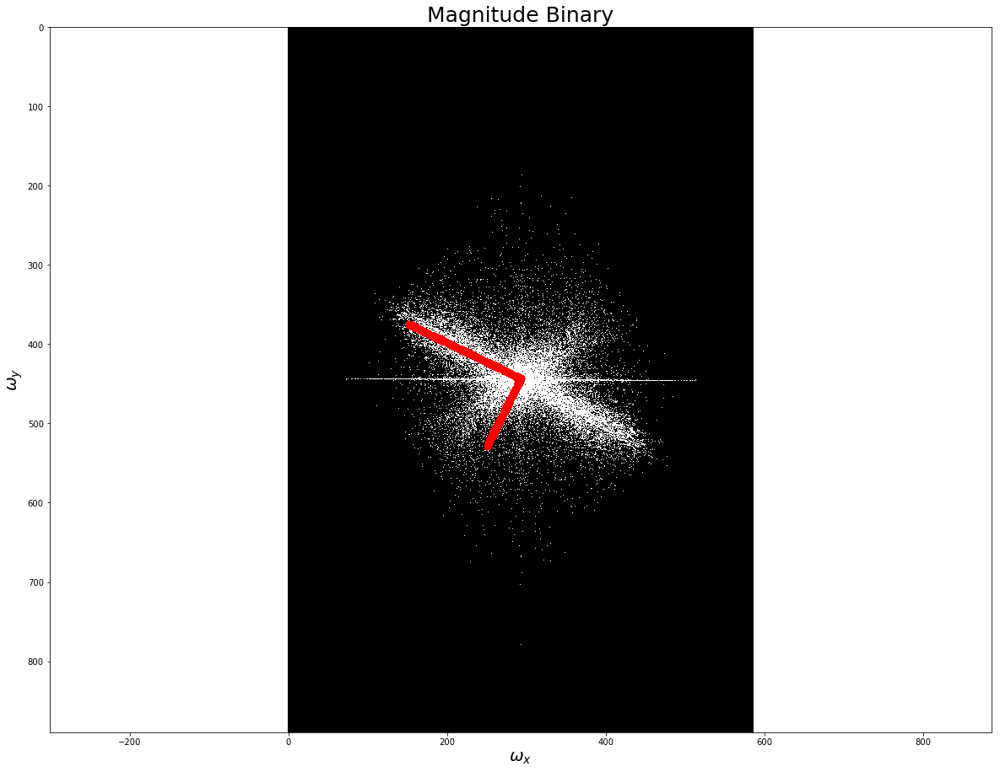

results_discussion/camera_135TCB_CB/135TCB_CB_sample16.jpeg
16


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -59.436 

The angle between the second component and the horizontal is 
        β = -30.564 

The alignment factor is: 0.551


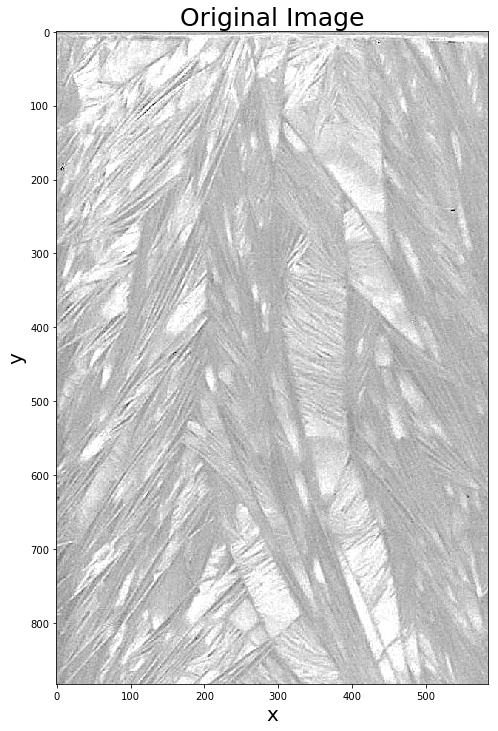

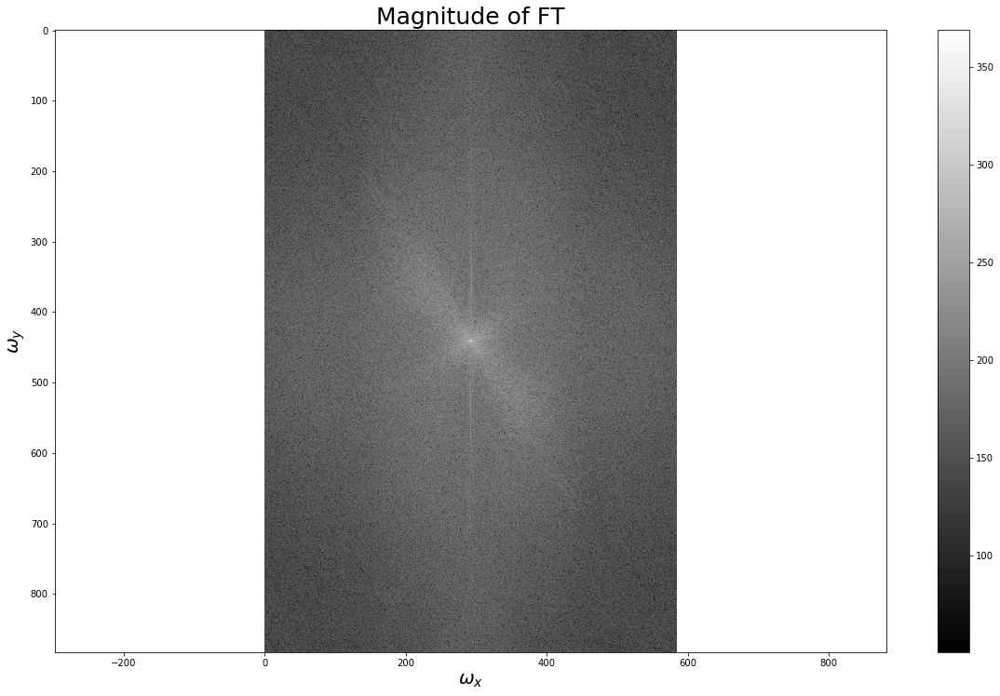

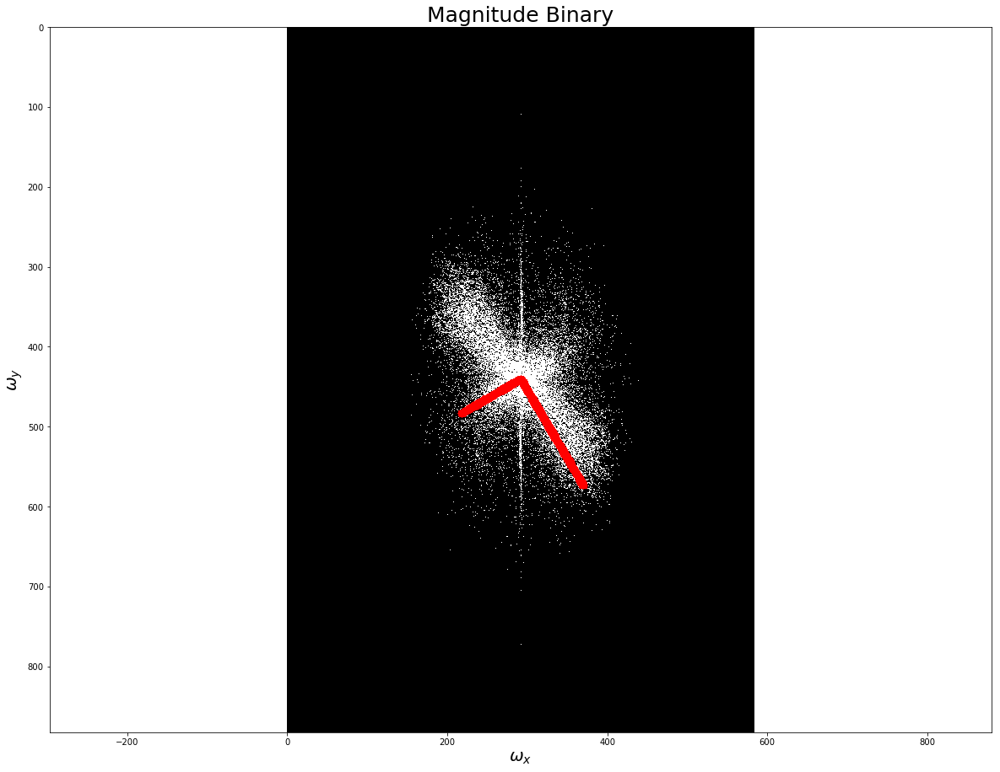

results_discussion/camera_135TCB_CB/135TCB_CB_sample6.jpeg
6


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -31.313 

The angle between the second component and the horizontal is 
        β = -58.687 

The alignment factor is: 0.768


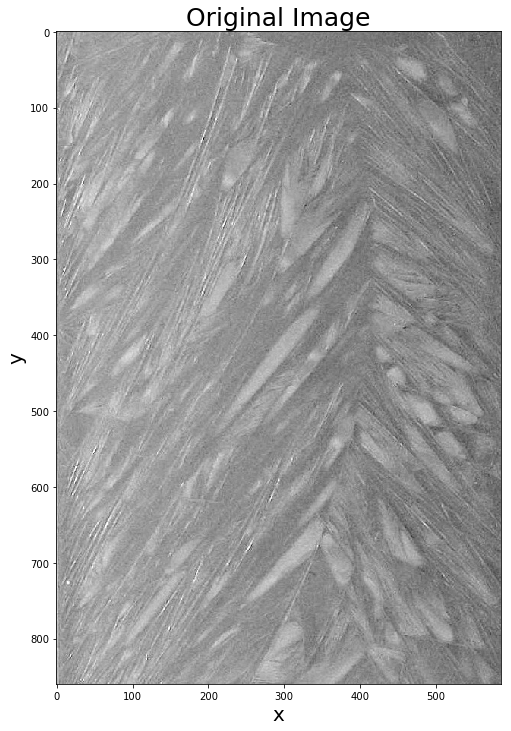

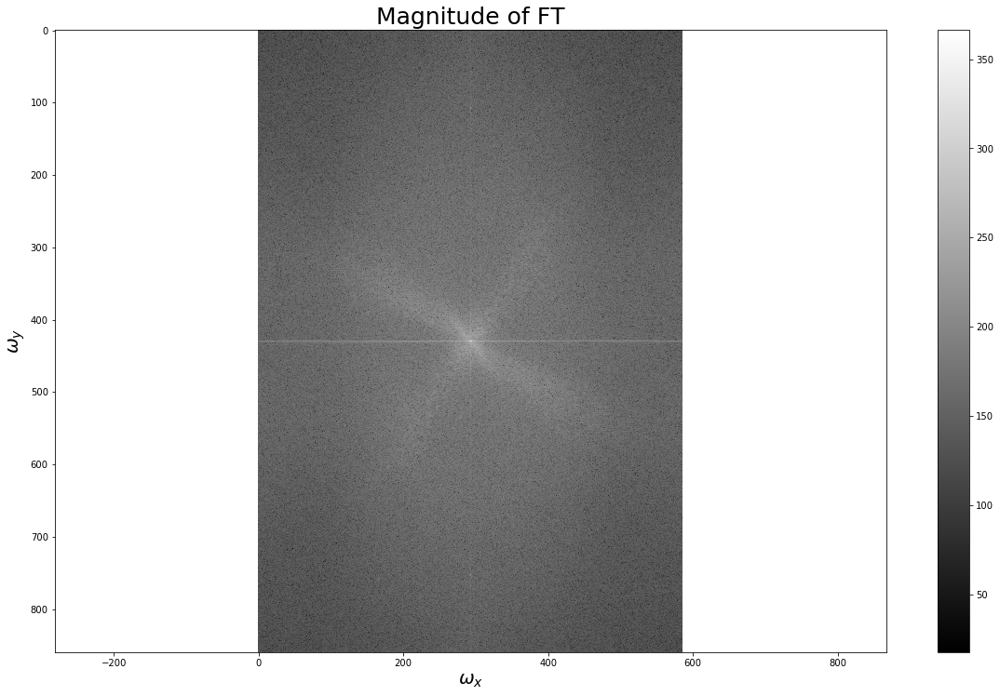

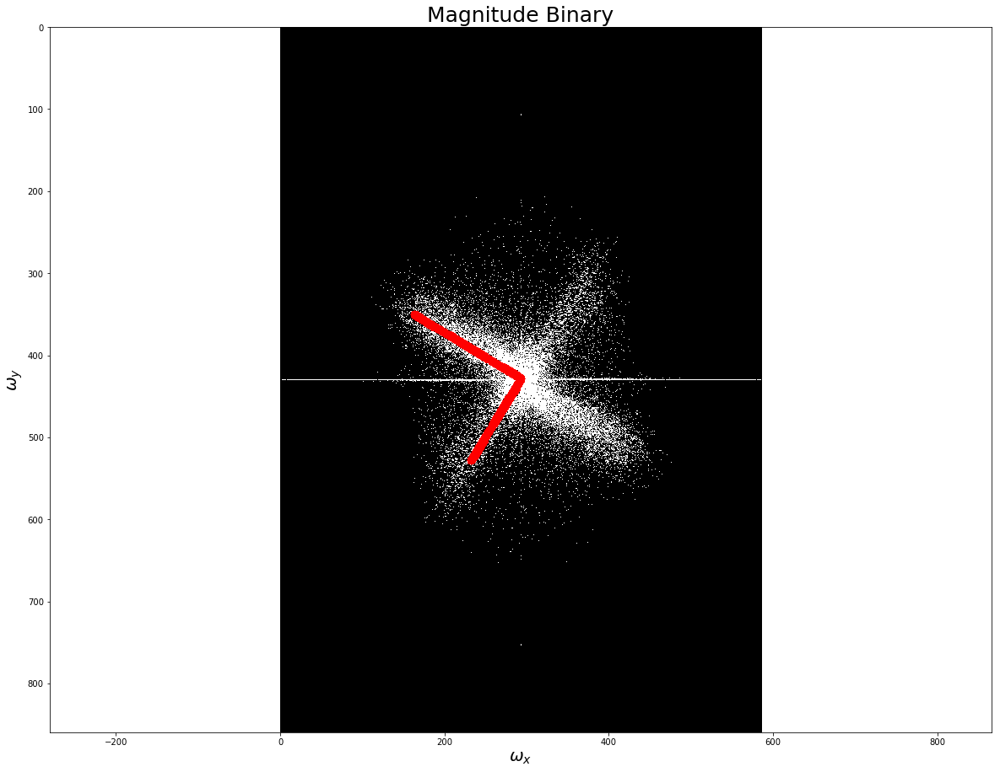

results_discussion/camera_135TCB_CB/135TCB_CB_sample20.jpeg
20


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -70.513 

The angle between the second component and the horizontal is 
        β = -19.487 

The alignment factor is: 0.665


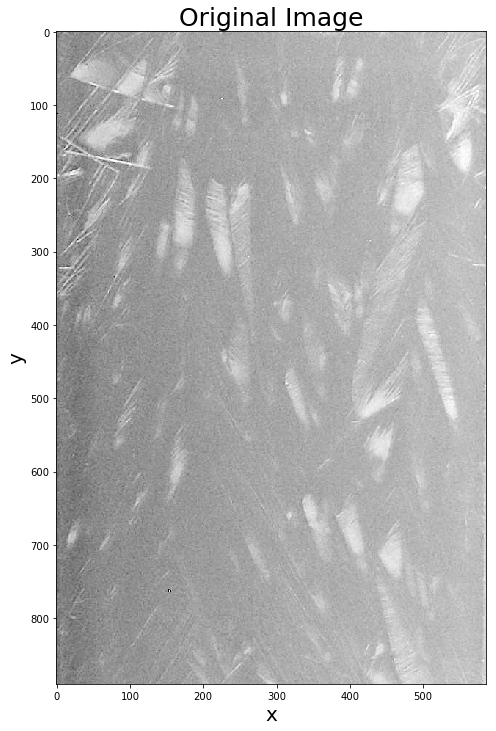

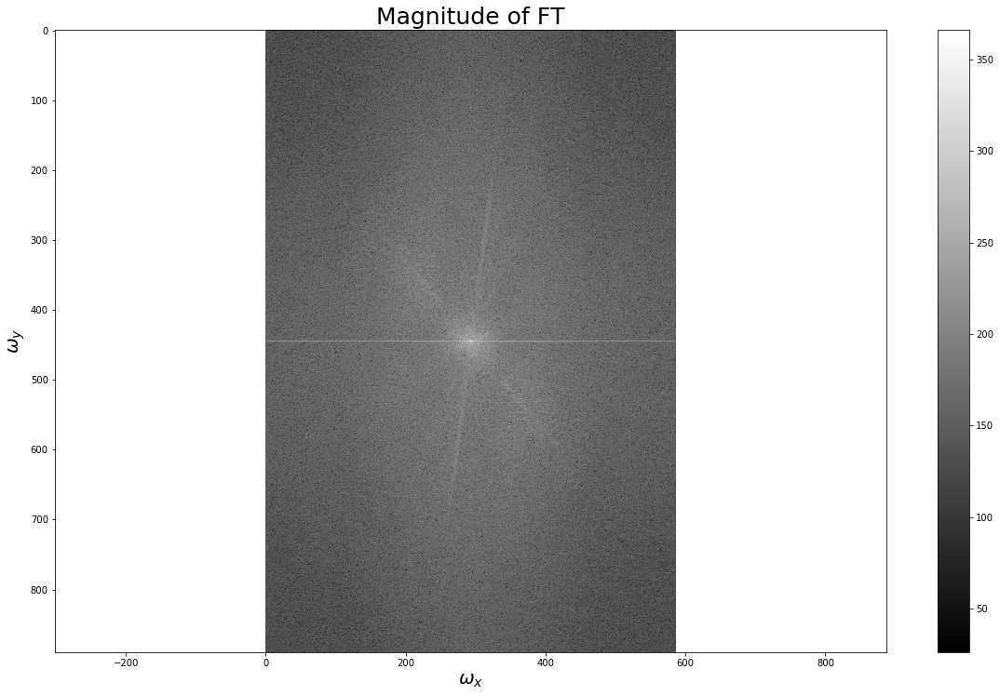

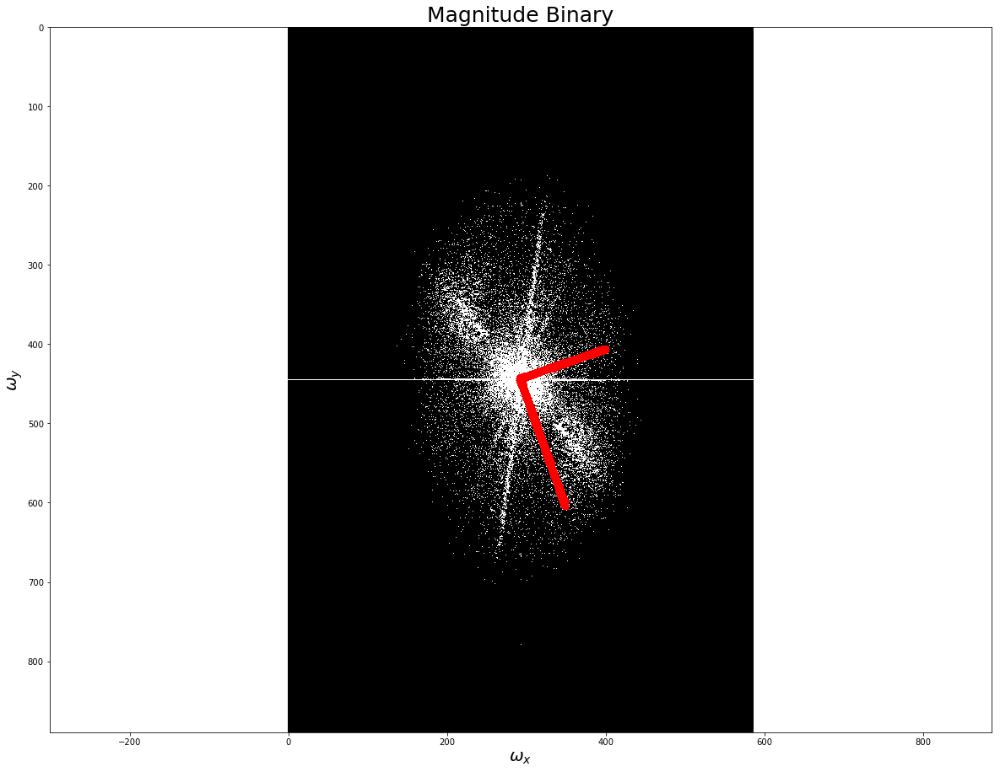

results_discussion/camera_135TCB_CB/135TCB_CB_sample21.jpeg
21


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -49.871 

The angle between the second component and the horizontal is 
        β = -40.129 

The alignment factor is: 0.597


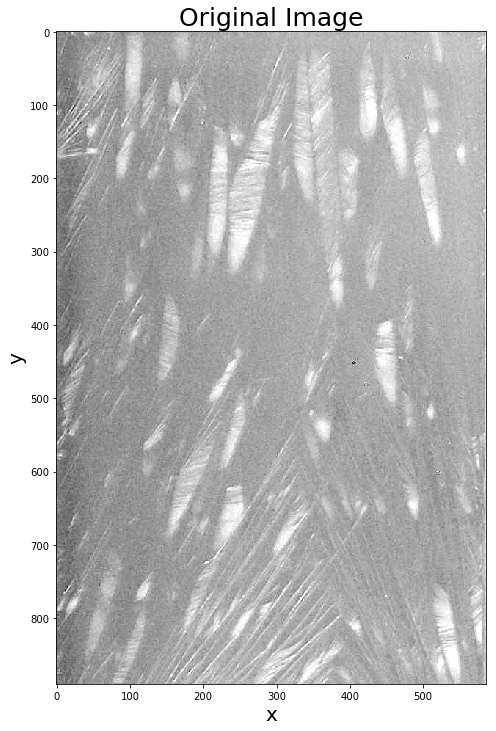

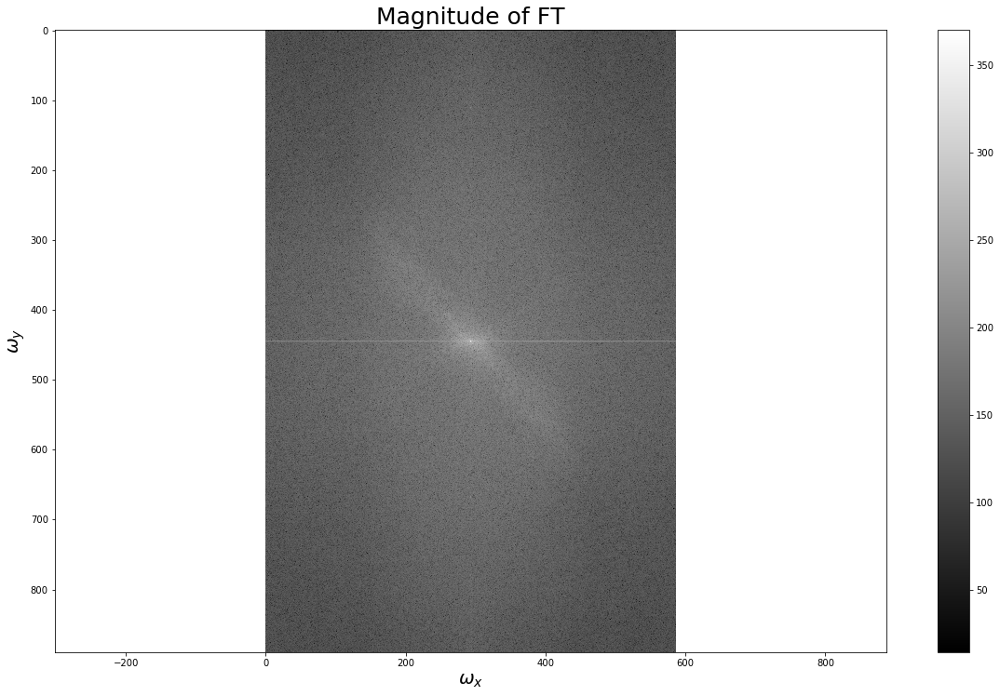

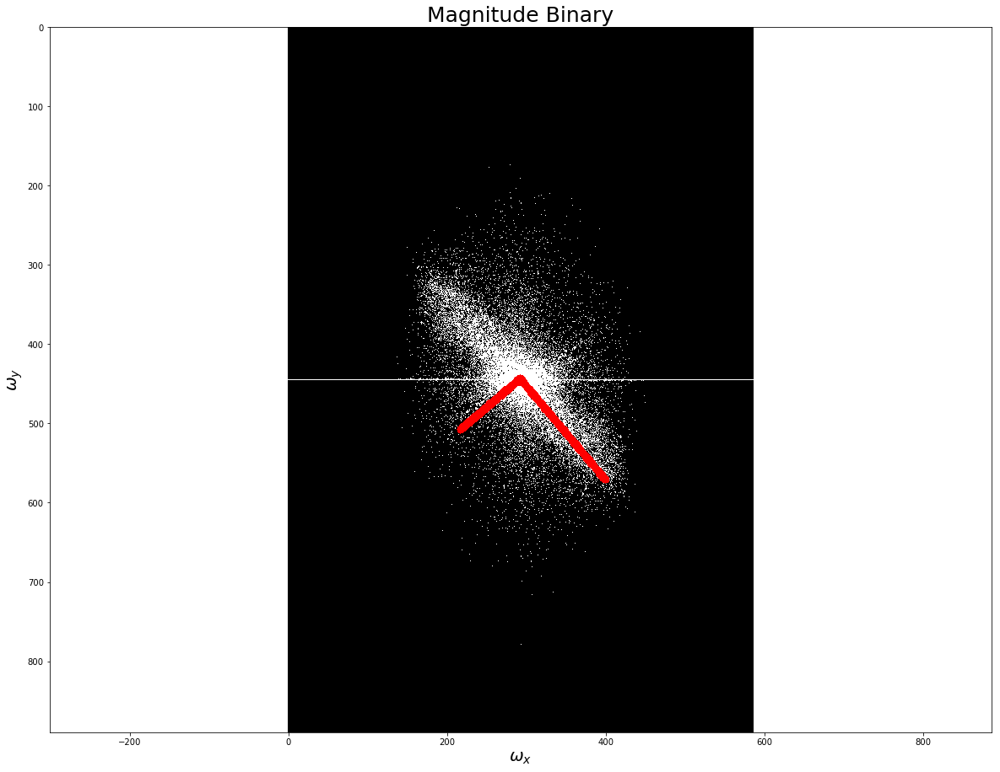

results_discussion/camera_135TCB_CB/135TCB_CB_sample7.jpeg
7


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -49.919 

The angle between the second component and the horizontal is 
        β = -40.081 

The alignment factor is: 0.523


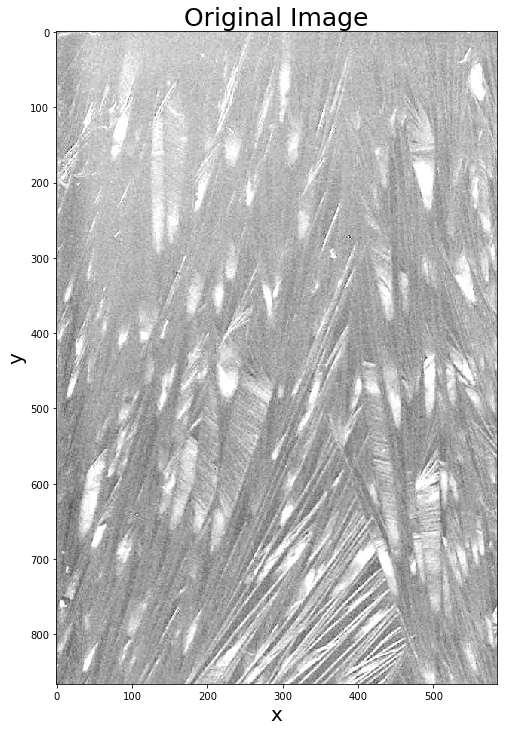

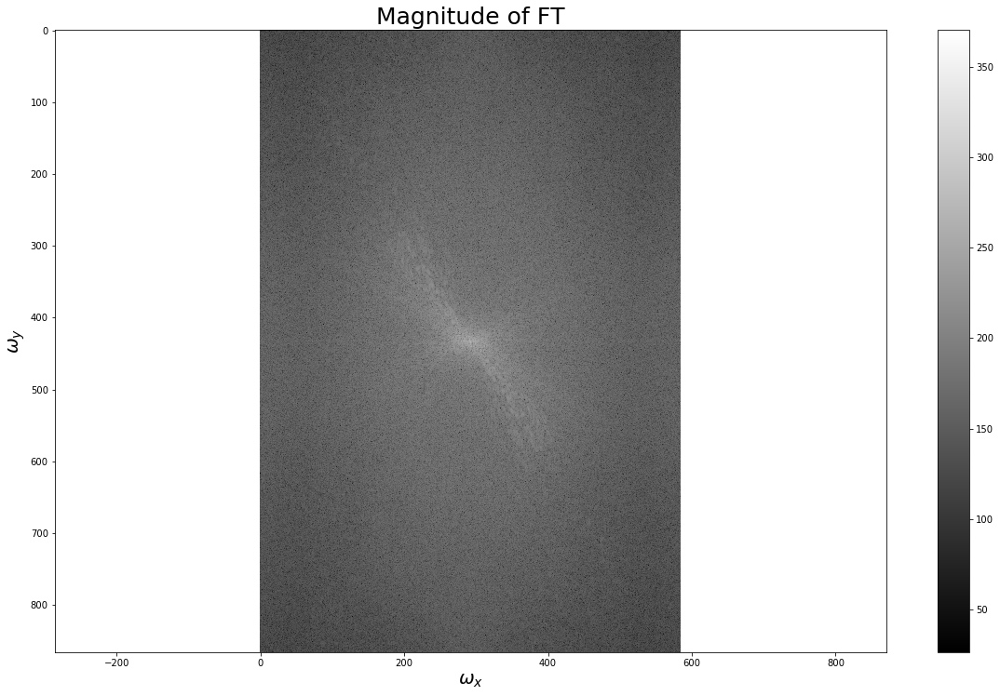

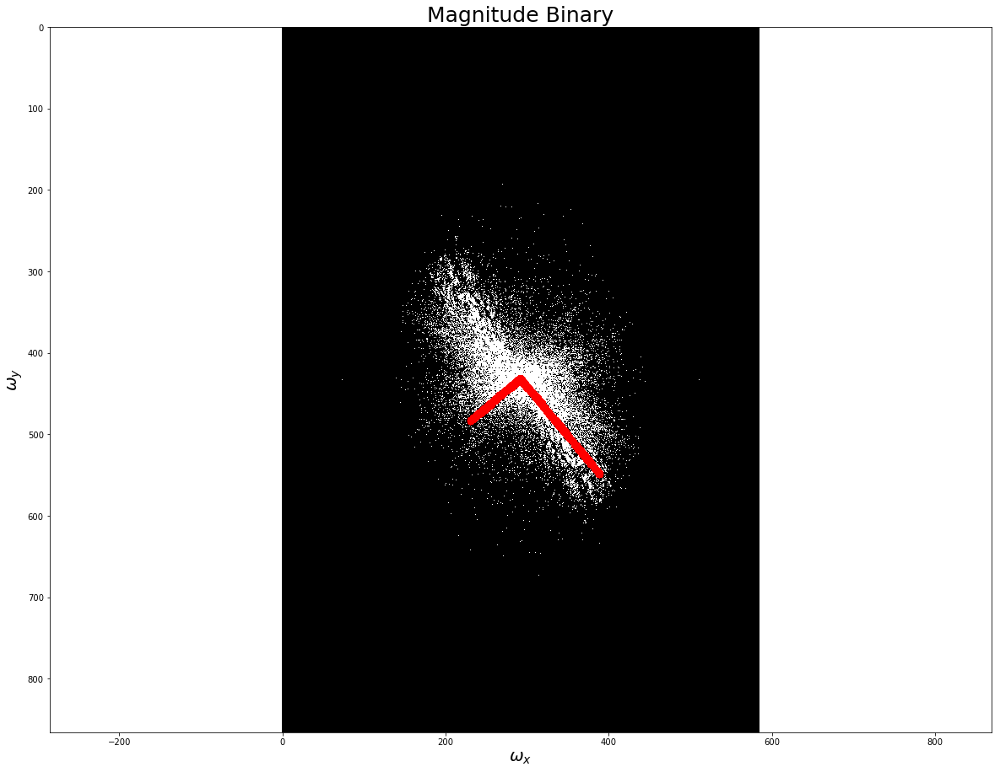

results_discussion/camera_135TCB_CB/135TCB_CB_sample17.jpeg
17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -47.676 

The angle between the second component and the horizontal is 
        β = -42.324 

The alignment factor is: 0.45


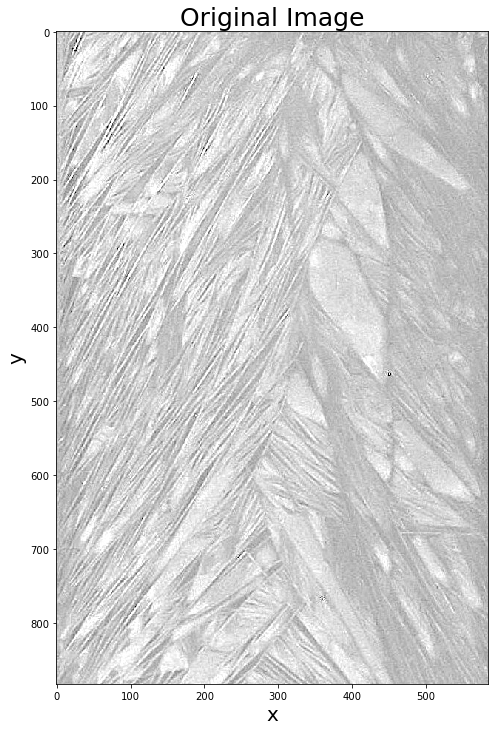

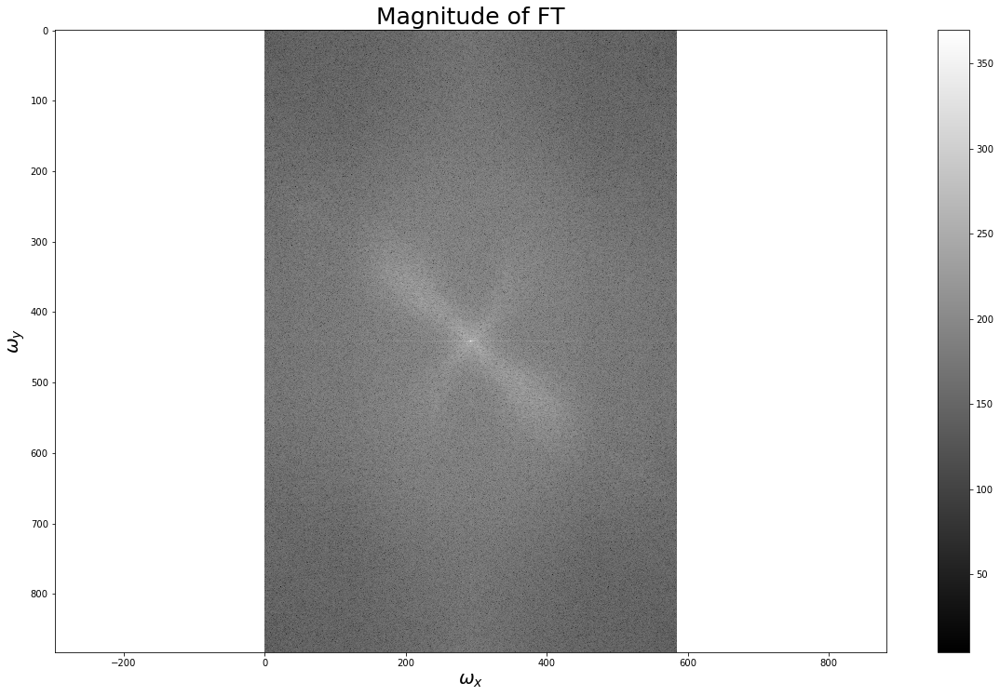

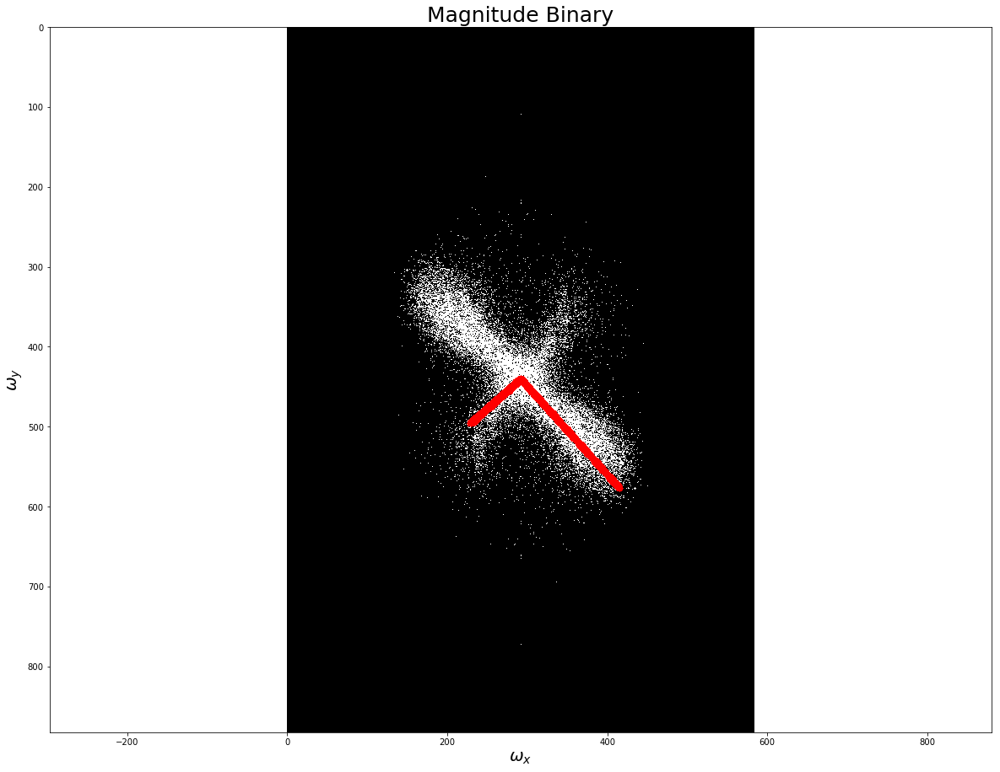

results_discussion/camera_135TCB_CB/135TCB_CB_sample30.jpeg
30


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = 46.764 

The angle between the second component and the horizontal is 
        β = 43.236 

The alignment factor is: 0.617


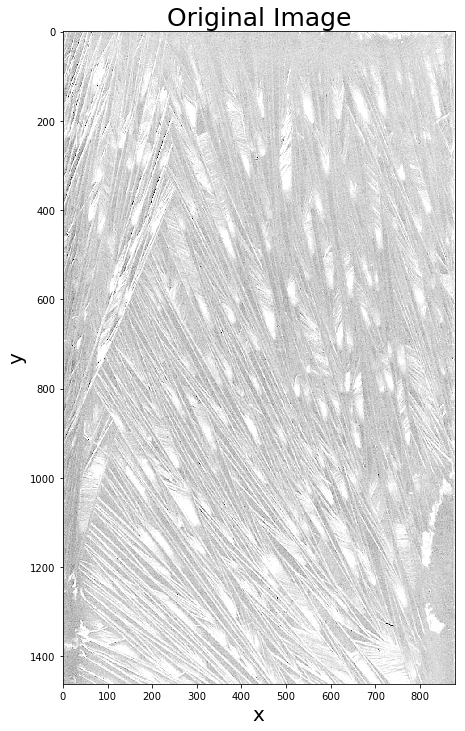

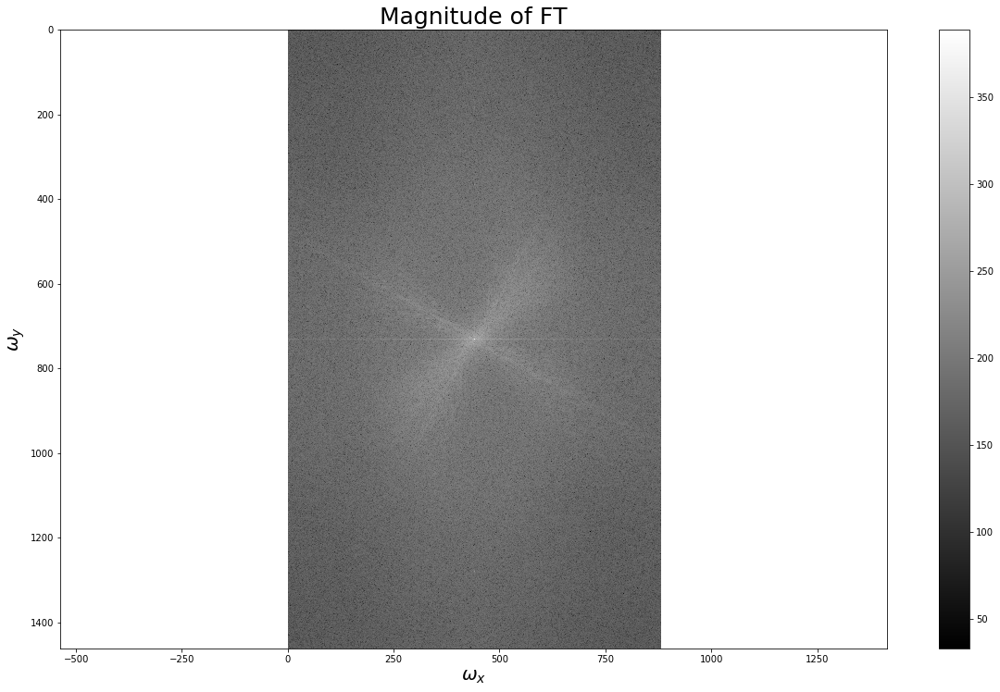

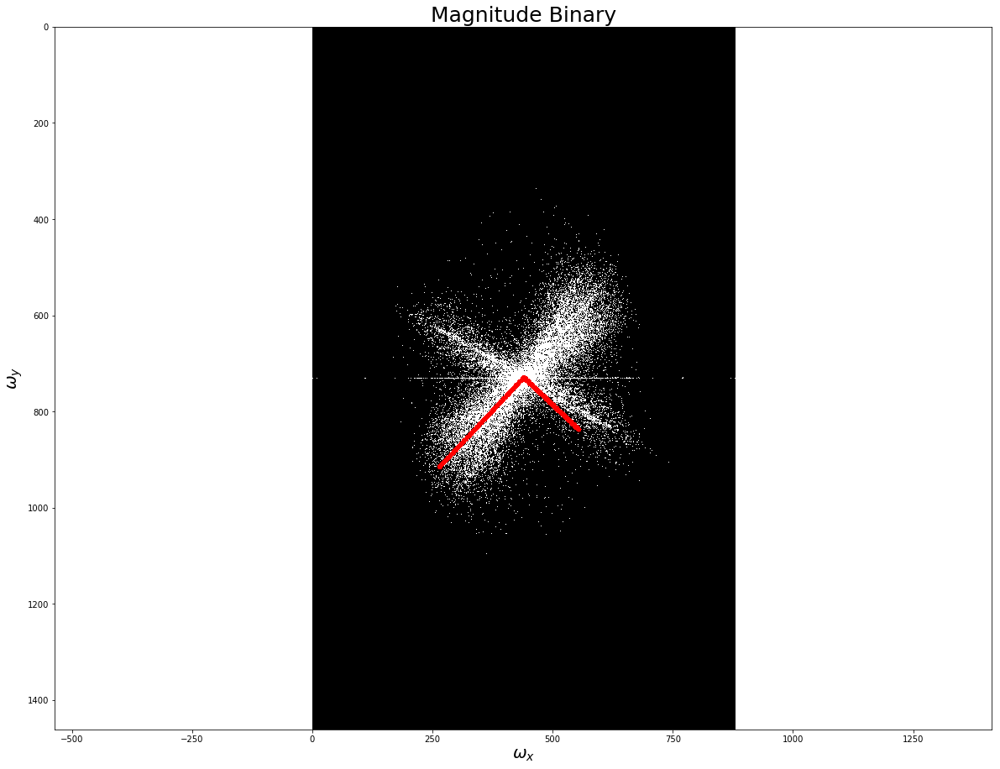

results_discussion/camera_135TCB_CB/135TCB_CB_sample26.jpeg
26


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -69.720 

The angle between the second component and the horizontal is 
        β = -20.280 

The alignment factor is: 0.724


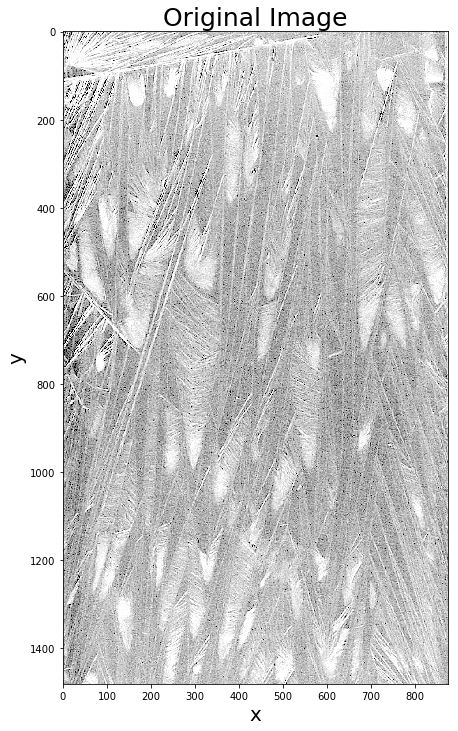

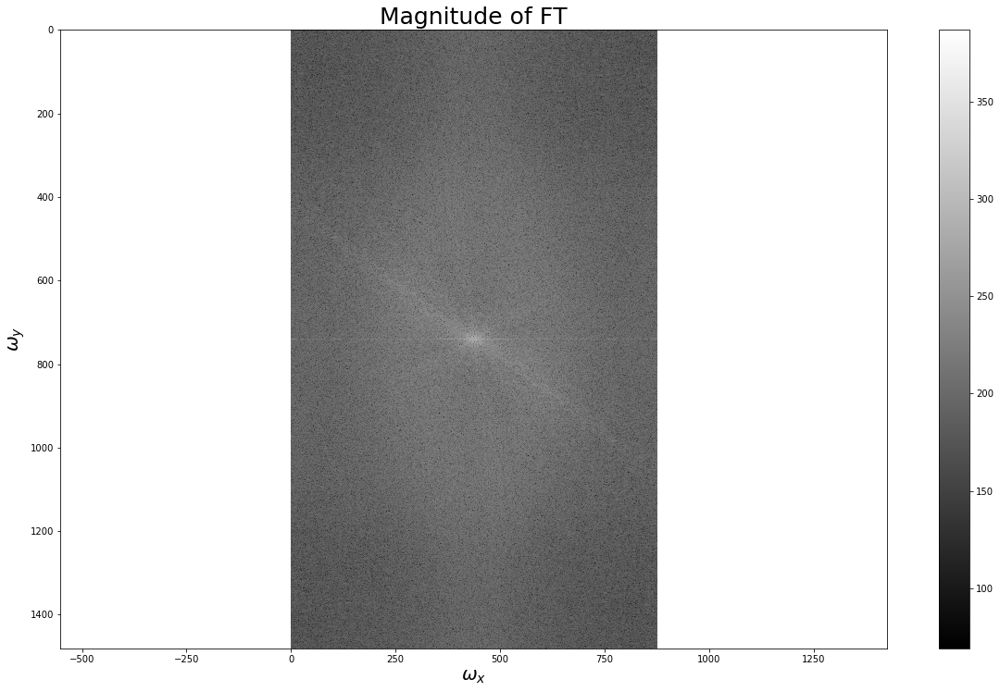

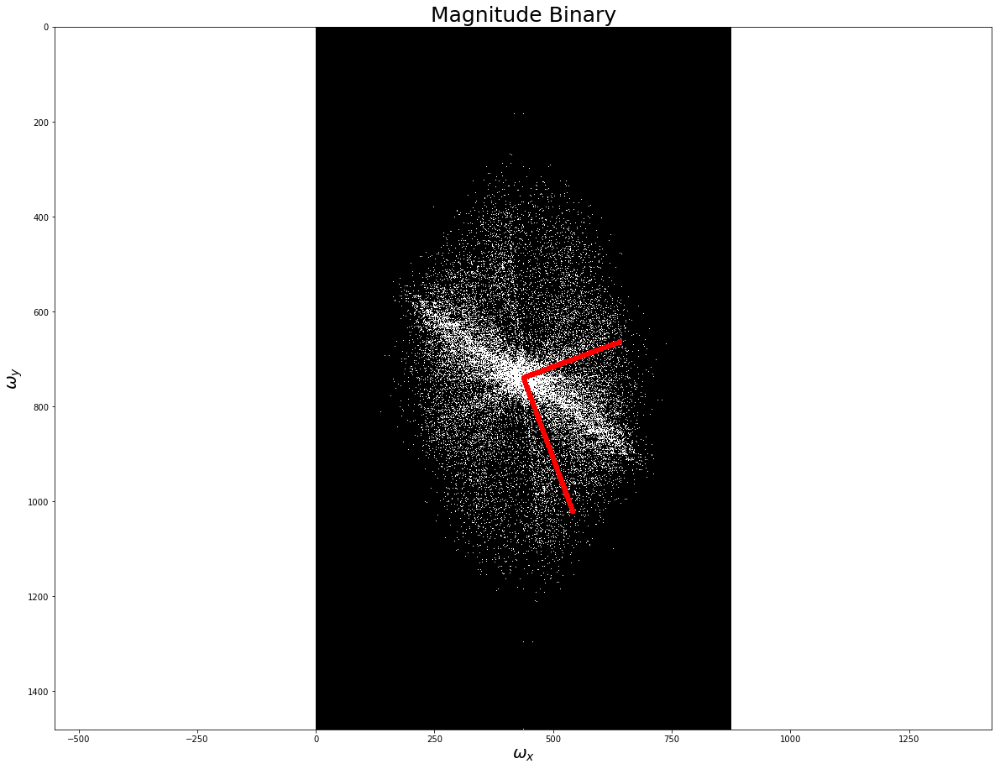

results_discussion/camera_135TCB_CB/135TCB_CB_sample10.jpeg
10


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -42.232 

The angle between the second component and the horizontal is 
        β = -47.768 

The alignment factor is: 0.741


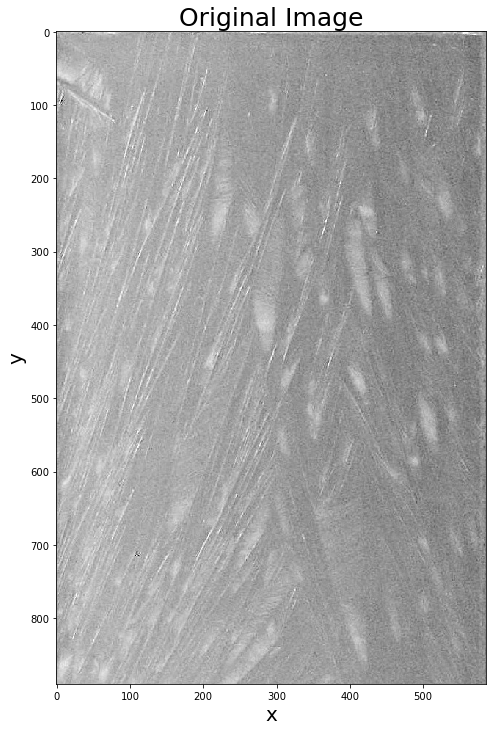

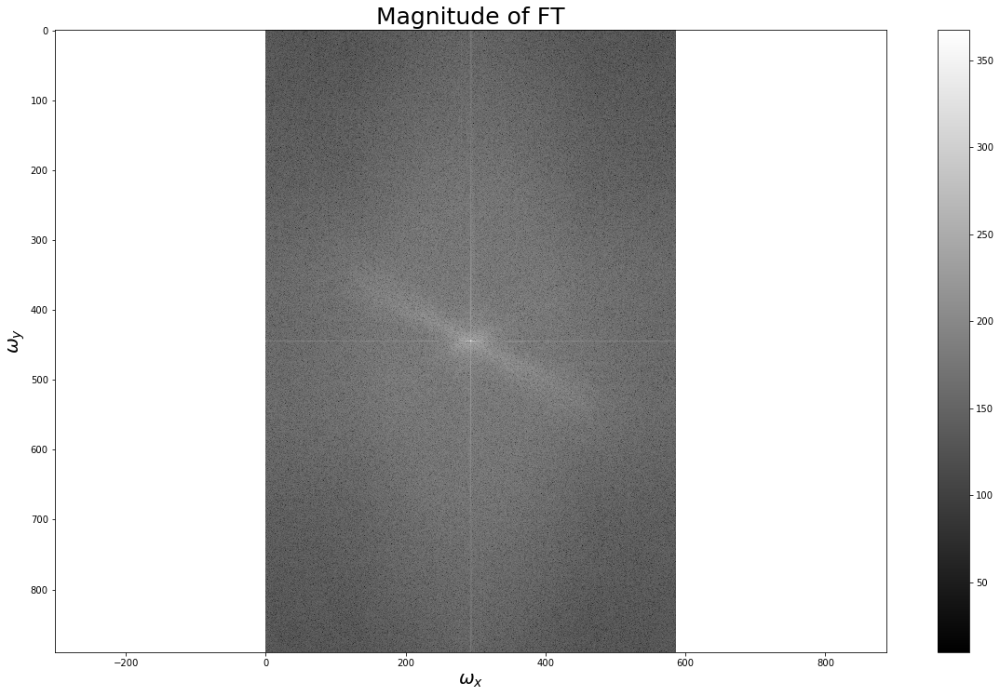

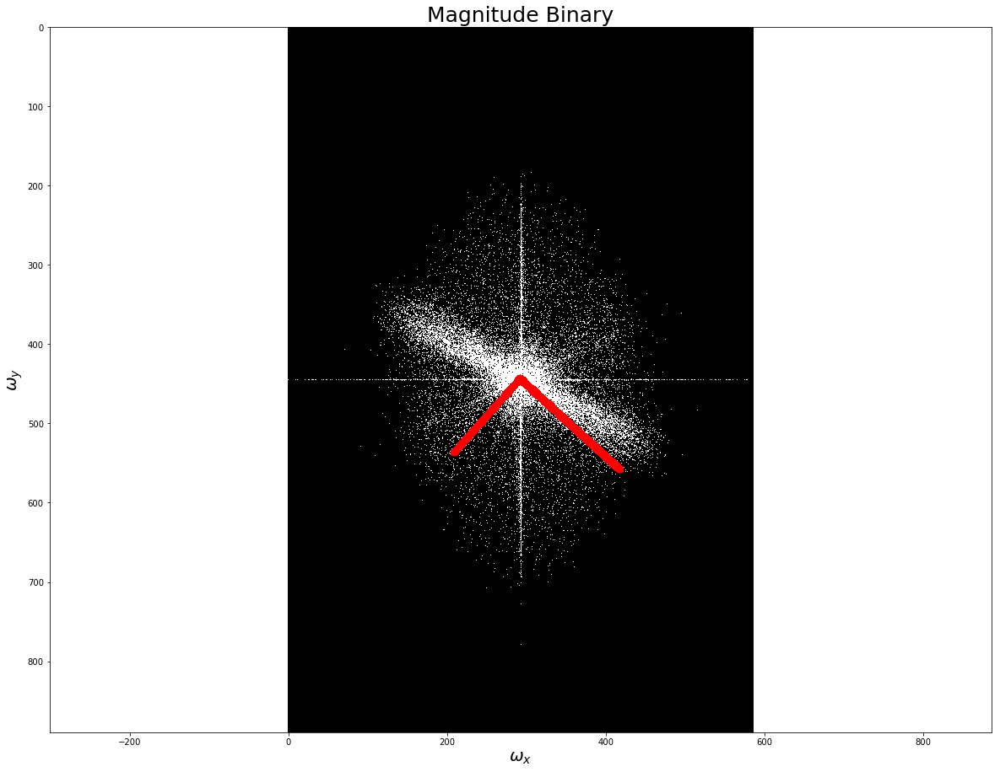

results_discussion/camera_135TCB_CB/135TCB_CB_sample11.jpeg
11


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -89.114 

The angle between the second component and the horizontal is 
        β = -0.886 

The alignment factor is: 0.692


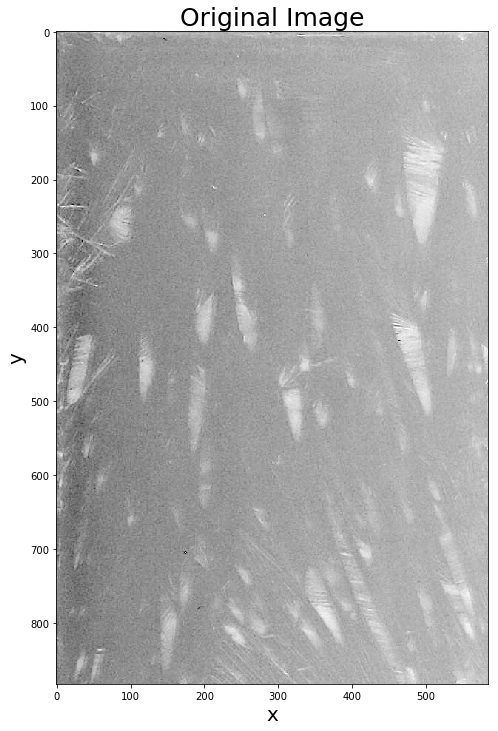

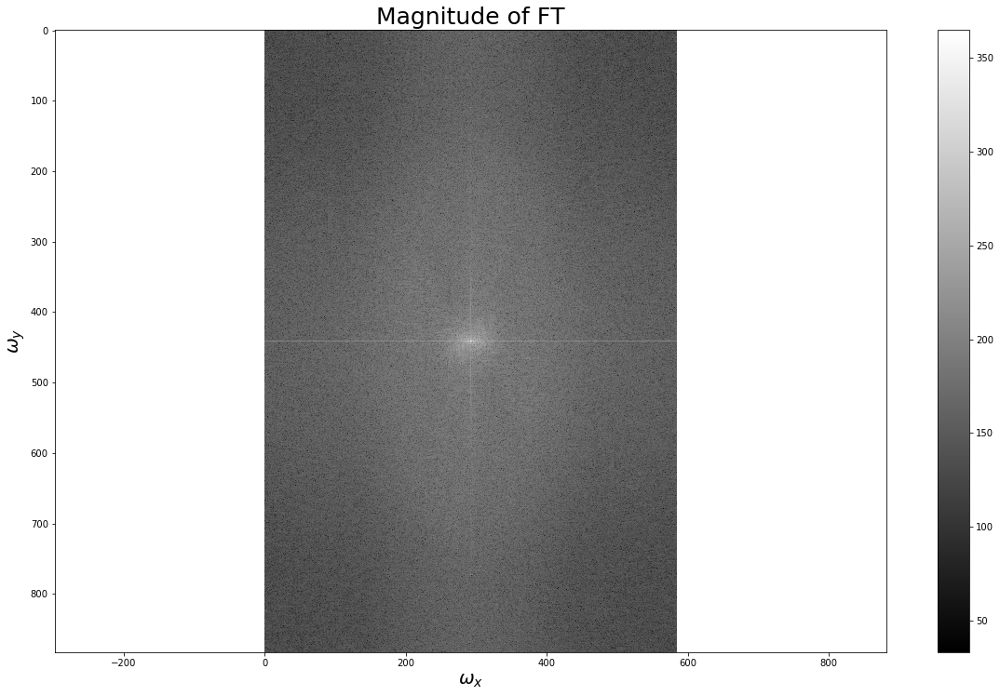

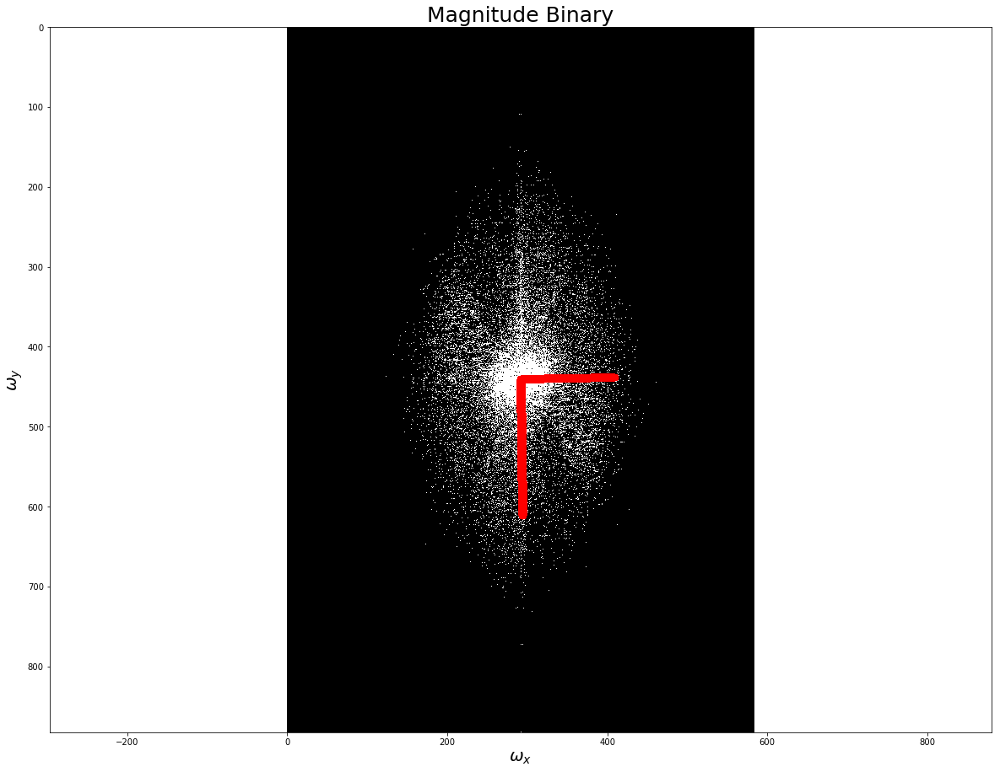

results_discussion/camera_135TCB_CB/135TCB_CB_sample27.jpeg
27


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -72.648 

The angle between the second component and the horizontal is 
        β = -17.352 

The alignment factor is: 0.692


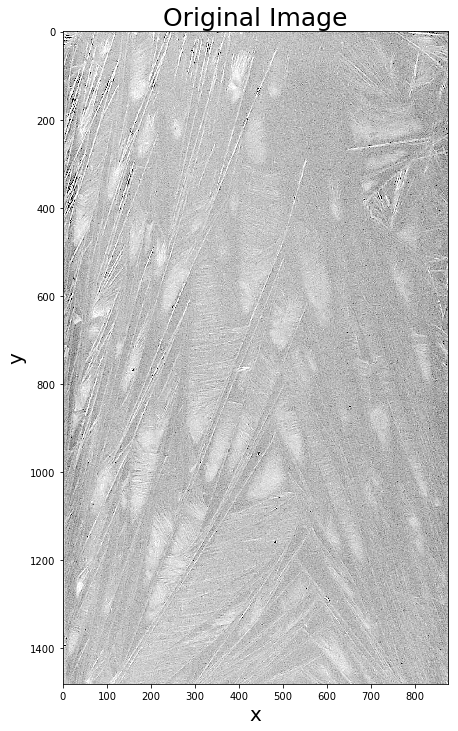

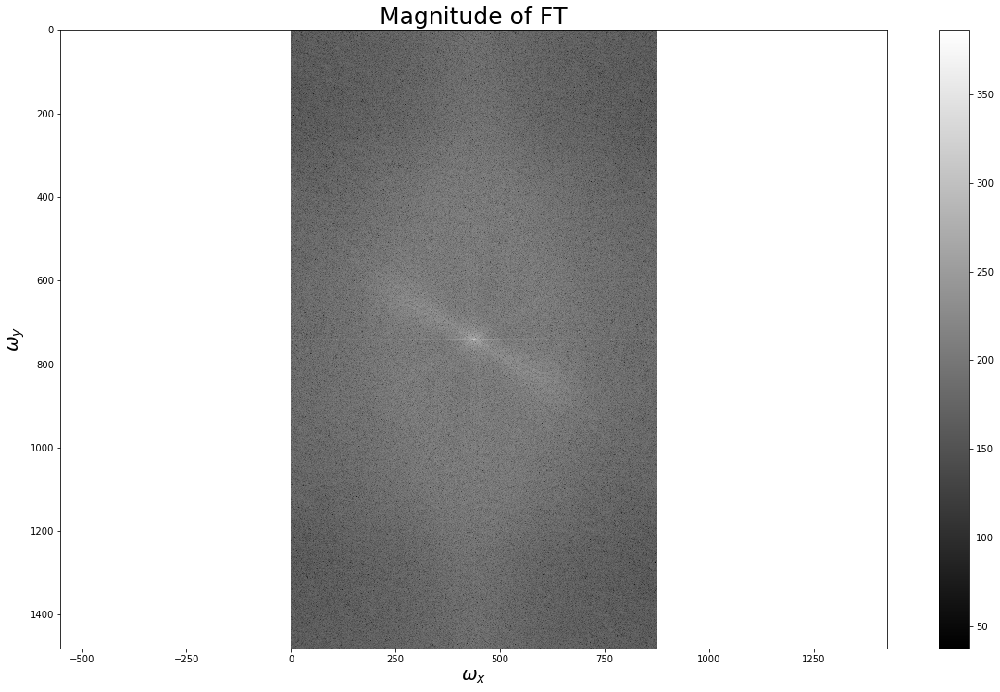

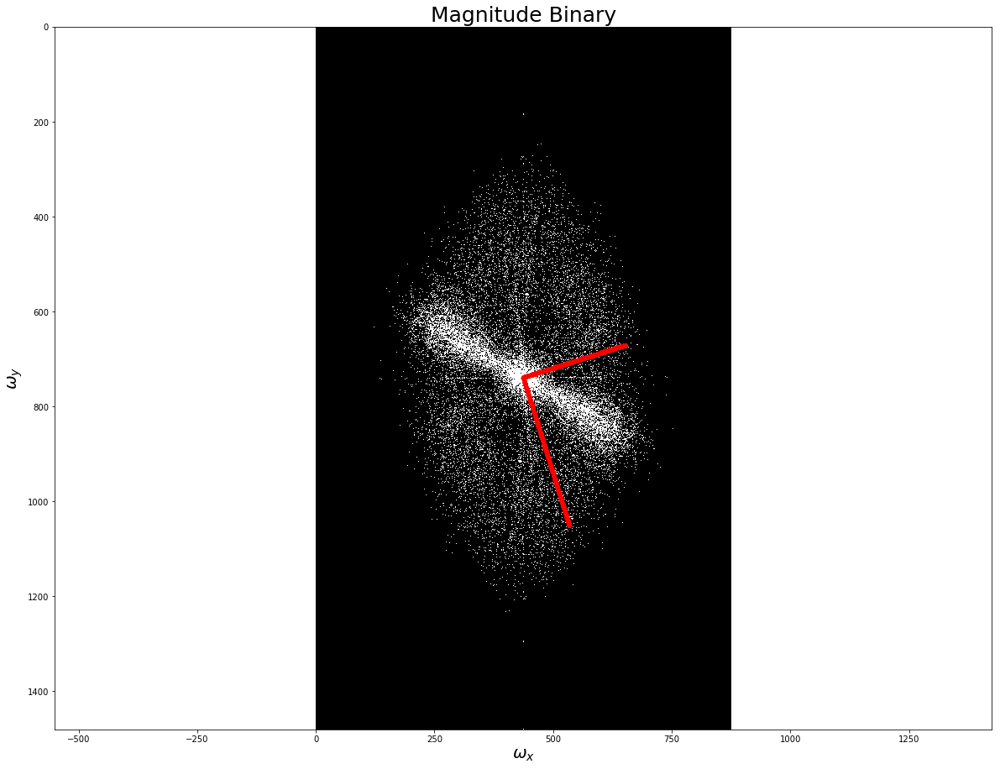

results_discussion/camera_135TCB_CB/135TCB_CB_sample31.jpeg
31


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -30.900 

The angle between the second component and the horizontal is 
        β = -59.100 

The alignment factor is: 0.968


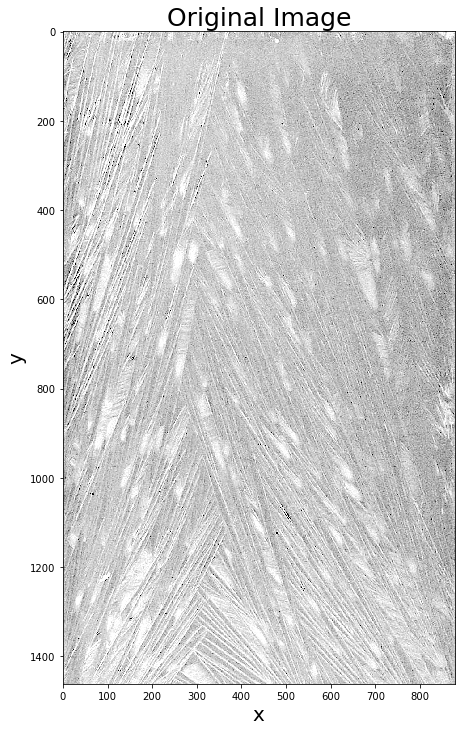

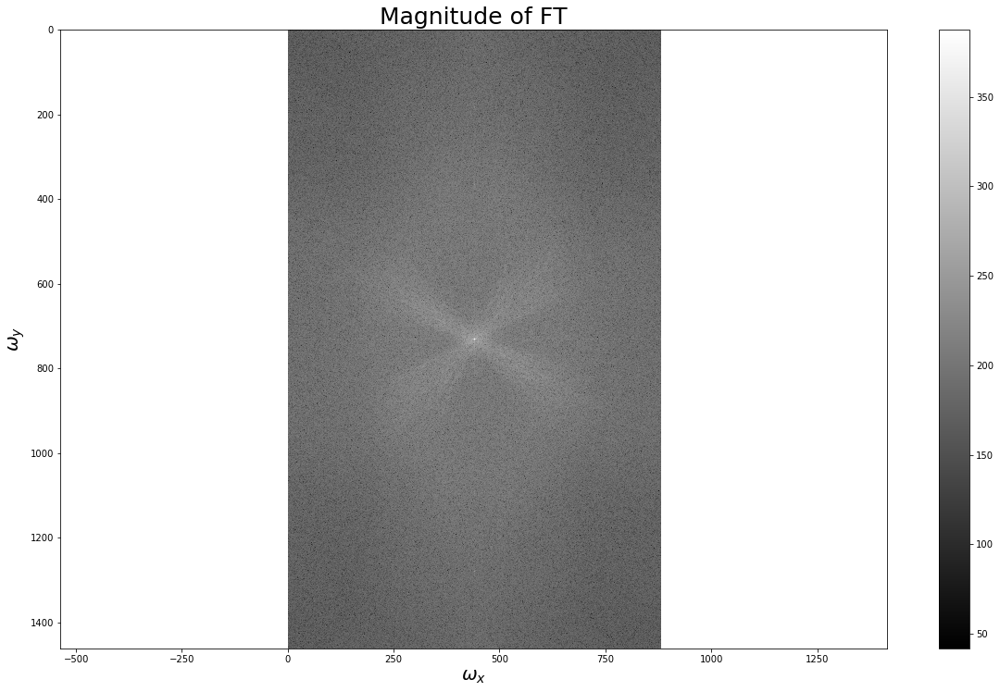

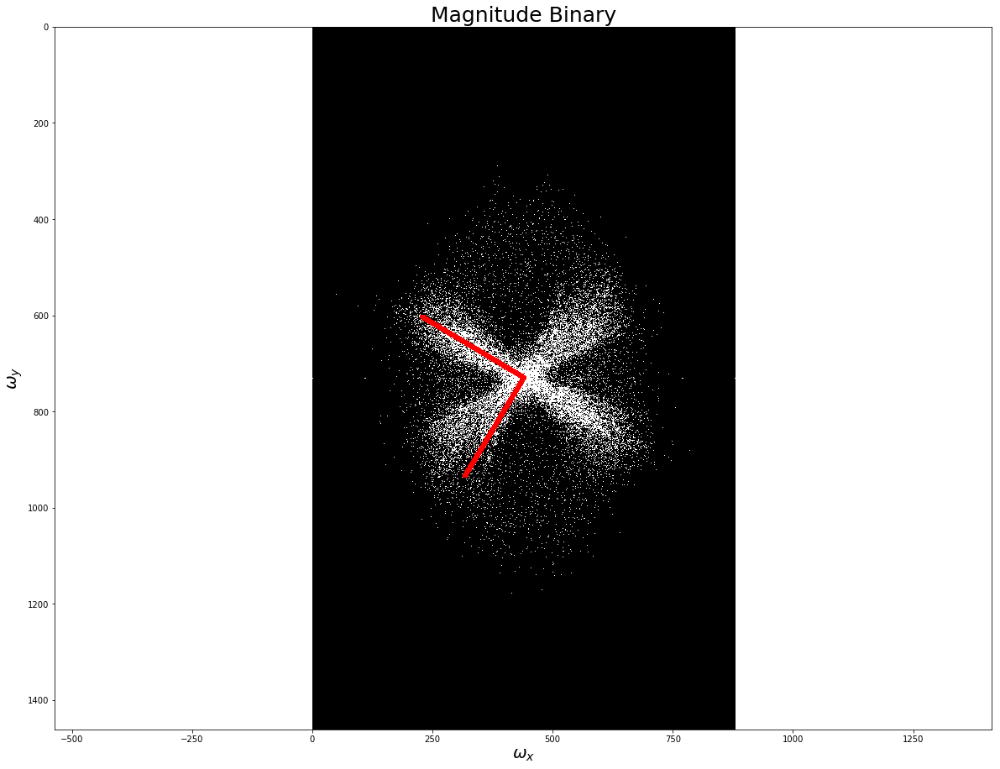

results_discussion/camera_135TCB_CB/135TCB_CB_sample1.jpeg
1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The angle between the main component and the horizontal is 
        α = -41.765 

The angle between the second component and the horizontal is 
        β = -48.235 

The alignment factor is: 0.638


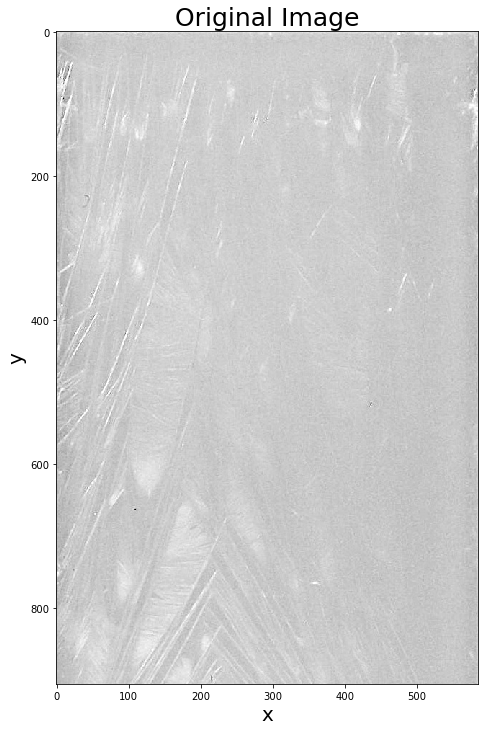

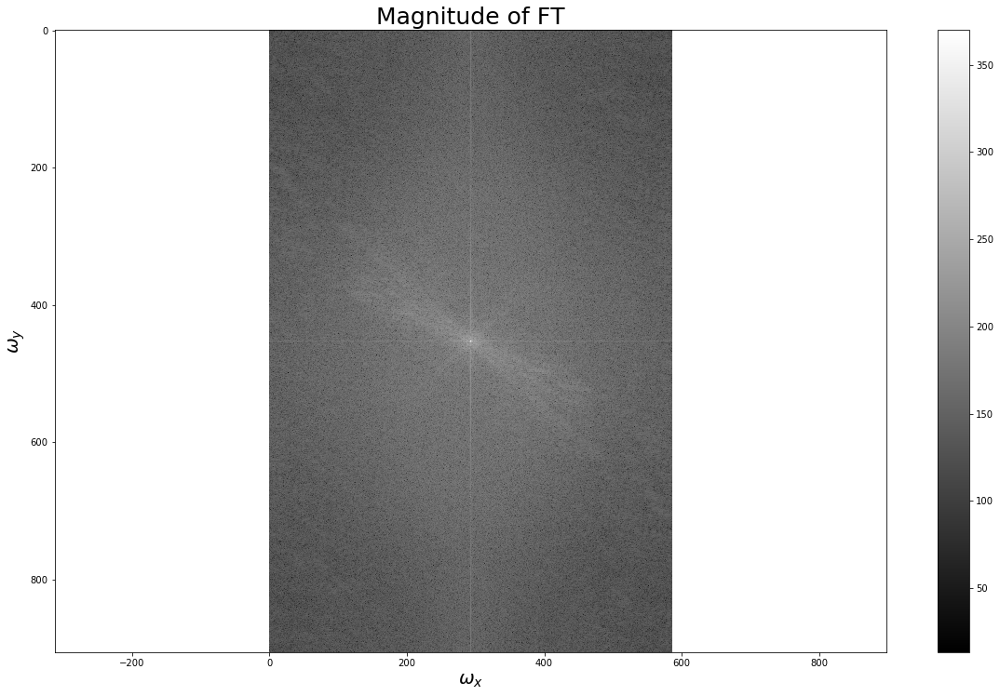

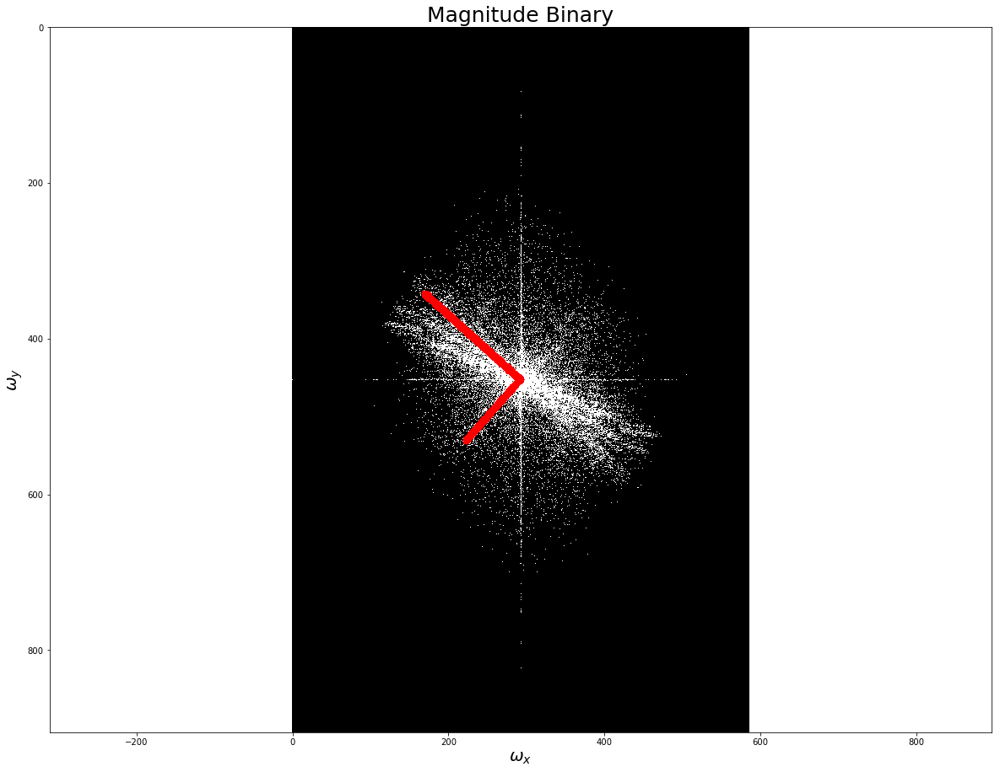

In [30]:
# first choose the folder
figfolder = "figures/"

#create folders if they do not exist already:
if not os.path.exists(folder + figfolder):
    os.makedirs(folder + figfolder)
    
AlignVec = np.ones(80)
AlignWvec = np.ones(80)

#runs over all .jpg files in the folder:
for item in glob.glob(folder + "*.jpeg"):
    #extracting the number of the measurement, the channel and tha name:
    #name, chanNum, measNum = hf.FindChanAndMeas(folder, item)
    
    print(item)
    
    idx = [i for i in range(len(item)) if item[i] == '/']
    name = item[idx[1]+1:np.max(idx)]
    
    idxup = item.find("sample")
    idxdown = item.find(".")
    sampleNum = item[idxup+6 : idxdown]
    print(sampleNum)
    if (len(sampleNum) > 2): sampleNum = sampleNum[0]
    
    alignFact, alignWvert,_ = find_main_component_dft(item, 3)
    
    AlignVec[int(sampleNum)-1] = alignFact
    AlignWvec[int(sampleNum)-1] = alignWvert
    

In [31]:
AlignVec
AlignWvec

array([ 48.23468829,  37.35827673,  43.46250082,  50.77248581,
        48.97460917,  58.6866179 ,  40.08079475,  65.34113065,
        63.94587084,  47.76816561,   0.88644601,  18.41566309,
        57.77570816,  31.70177686,  37.92642068,  30.56397567,
        42.32362227, 159.24136272,   1.        ,  19.48729588,
        40.12854609,  24.13504123,  41.55464829,   3.01721403,
         5.80109097,  20.27958062,  17.35211444,   2.46764628,
        15.16000928, 136.76406843,  59.10030527, 169.48405808,
        36.09307336,   1.        ,   1.        ,   1.        ,
         1.        ,   1.        ,   1.        ,   1.        ,
         1.        ,   1.        ,   1.        ,   1.        ,
         1.        ,   1.        ,   1.        ,   1.        ,
         1.        ,   1.        ,   1.        ,   1.        ,
         1.        ,   1.        ,   1.        ,   1.        ,
         1.        ,   1.        ,   1.        ,   1.        ,
         1.        ,   1.        ,   1.        ,   1.  